In [1]:
import os
import itertools
import pathos
import functools
from functools import partial

import numpy as np
from scipy import stats as st
from sklearn.feature_selection import mutual_info_regression as MI

import plotly.graph_objects as go
from matplotlib import pyplot as plt
import seaborn as sns
sns.set()

import sys
sys.path.append('/home/leonardo/git/bayesian_bss')
from src import MAPGradientEstimator, InstantaneousMixtureModel

np.random.seed(2000)

In [2]:
# Number of sources and observations
NSOURCES=2
NOBS=10000

# Define initial conditions for optimizations
initial_B = np.random.normal(
    0,1,
    (NSOURCES, NSOURCES, 1)
)

# Learning rate
learning_rate=1E-3

# Optimization configs
thresh = 0.0005
max_it=100000

# ENSAIO - CURVAS DE DESEMPENHO MAP

#### Objetivos:
#### - Verificar o efeito da especificação da distribuição a priori bayesiana (boa ou ruim) sobre ponto de convergência de estimação de matriz de separação;
#### - Verificar o efeito da especificação da distribuição das fontes (boa ou ruim) sobre ponto de convergência de estimação de matriz de separação;

#### Para tal:
####  - Constroem-se gráficos da vizinhança estimada do ponto ótimo (verdadeiro), seguindo exercício feito em Cardoso (1998)
####  - Realizam-se otimizações com o objetivo de determinar a matriz de separação, simulando um cenário de separação de fontes. Nas otimizações, a condição inicial é colocada próxima à verdadeira, para que, a partir de uma convergência facilitada, possa ser determinado o ponto global de máximo nos vários cenários testados.

# Função a ser otimizada (probabilidade a posteriori)

#### De Djafari, 2000
$$ \log P(\boldsymbol{B}|y) = T \log |det({B})| + \sum_{t} \sum_{i} \log p_{i}(y_{i}(t)) + \log P(\boldsymbol{B}) + cte$$

# Equação de otimização (derivada)

#### De Taylor, 2008
$$ \Delta \boldsymbol{B} \varpropto (\boldsymbol{B}^{-1})^{T} + \frac{1}{T} \sum_{T} g(\boldsymbol{Bx}) \boldsymbol{x}^{T} + \frac{1}{T} h(\boldsymbol{B})$$

# 1. PERFECT MODEL

## 1.1. Initialize Sources

In [3]:
def source_cumulative(x):
    return 1/(1+np.exp(-x))

def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def source_generator(
    nsources,
    nobs,
    mu
):
    return np.random.logistic(
        loc=mu,
        scale=1,
        size=(nsources, nobs)
    )

In [4]:
MU=0.0

s = source_generator(
    nsources=NSOURCES,
    nobs=NOBS,
    mu=MU
)

print('-'*100)
print('NÚMERO DE FONTES: {}'.format(NSOURCES))
print('TAMANHO DOS SINAIS DAS FONTES: {}'.format(NOBS))
for i in range(s.shape[0]):
    print(
        'CURTOSE s{}: {}'.format(
            i,
            st.kurtosis(a=s[i,:])
        )
    )
    
print('-'*100)

----------------------------------------------------------------------------------------------------
NÚMERO DE FONTES: 2
TAMANHO DOS SINAIS DAS FONTES: 10000
CURTOSE s0: 0.9273716006264192
CURTOSE s1: 1.185617783891403
----------------------------------------------------------------------------------------------------


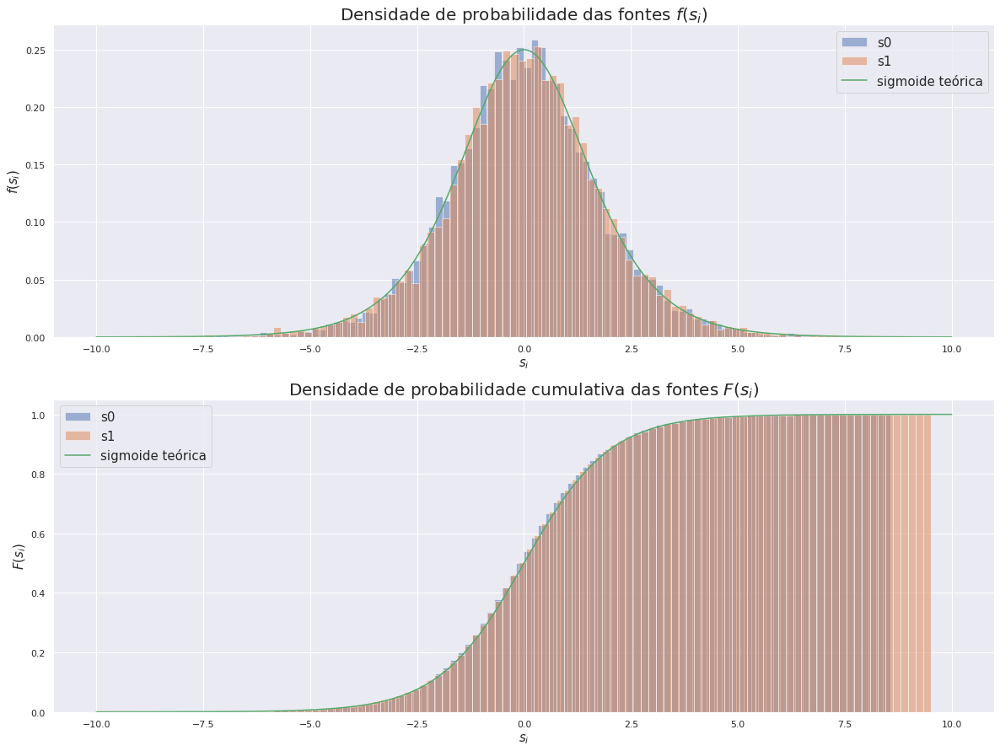

In [5]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)


for i in range(1, NSOURCES+1):
    ax1.hist(
        x=s[i-1,:],
        bins=100,
        density=True,
        label='s{}'.format(i-1),
        alpha=0.5
    )
    ax2.hist(
        x=s[i-1,:],
        bins=100,
        cumulative=True,
        density=True,
        label='s{}'.format(i-1),
        alpha=0.5
    )
    
ax1.plot(
    np.linspace(-10,10,1000),
    [source_pdf(x) for x in np.linspace(-10,10,1000)],
    label='sigmoide teórica'
)


ax2.plot(
    np.linspace(-10,10,1000),
    [source_cumulative(x) for x in np.linspace(-10,10,1000)],
    label='sigmoide teórica'
)

ax1.set_xlabel(
    '$s_{i}$',
    fontsize=15
)
ax1.set_ylabel(
    '$f(s_{i})$',
    fontsize=15
)
ax1.set_title(
    'Densidade de probabilidade das fontes $f(s_{i})$',
    fontsize=20
)

ax2.set_xlabel(
    '$s_{i}$',
    fontsize=15
)
ax2.set_ylabel(
    '$F(s_{i})$',
    fontsize=15
)
ax2.set_title(
    'Densidade de probabilidade cumulativa das fontes $F(s_{i})$',
    fontsize=20
)

l1=ax1.legend(fontsize=15)
l2=ax2.legend(fontsize=15)

## 1.2. Mix sources and generate observations

In [6]:
# Mixing matrix
A = np.array([
    [1, 1],
    [-0.5, 0.5]
])
print('MIXING MATRIX A:')
print(A)

MIXING MATRIX A:
[[ 1.   1. ]
 [-0.5  0.5]]


In [7]:
initial_B = np.linalg.inv(
    A
) + np.random.normal(
    0,0.1,
    A.shape
)
initial_B = initial_B.reshape(
    (NSOURCES, NSOURCES, 1)
)

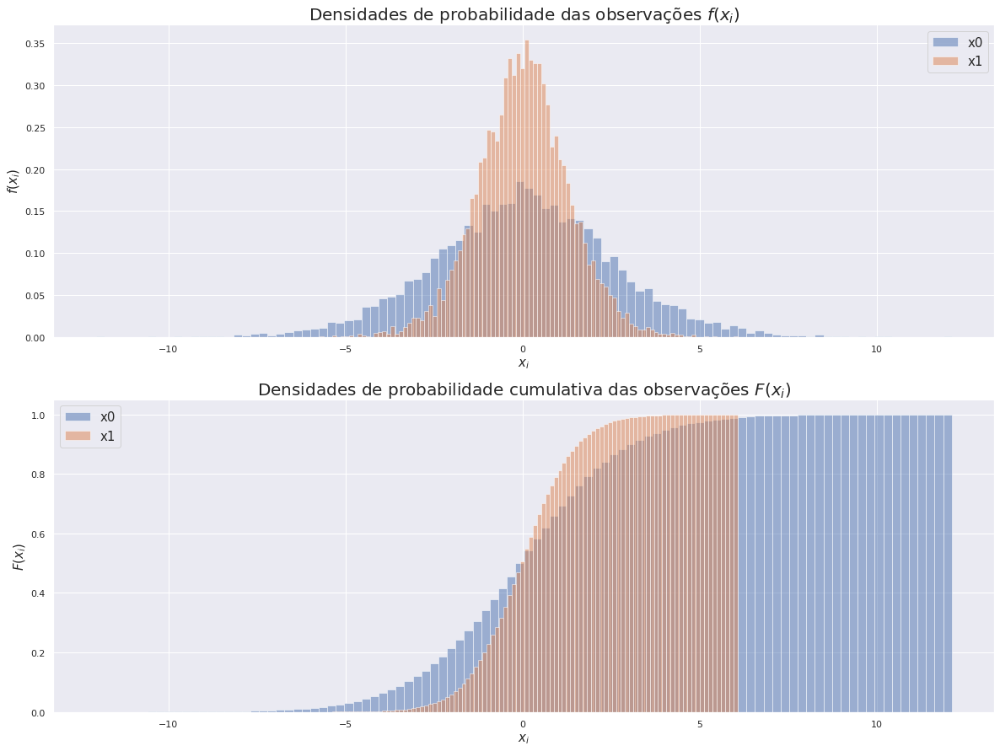

In [8]:
# Observed sources
x = A@s

fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)

for i in range(1, NSOURCES+1):
    ax1.hist(
        x=x[i-1,:],
        bins=100,
        density=True,
        label='x{}'.format(i-1),
        alpha=0.5
    )
    ax2.hist(
        x=x[i-1,:],
        bins=100,
        cumulative=True,
        density=True,
        label='x{}'.format(i-1),
        alpha=0.5
    )

ax1.set_xlabel(
    '$x_{i}$',
    fontsize=15
)
ax1.set_ylabel(
    '$f(x_{i})$',
    fontsize=15
)
ax1.set_title(
    'Densidades de probabilidade das observações $f(x_{i})$',
    fontsize=20
)

ax2.set_xlabel(
    '$x_{i}$',
    fontsize=15
)
ax2.set_ylabel(
    '$F(x_{i})$',
    fontsize=15
)
ax2.set_title(
    'Densidades de probabilidade cumulativa das observações $F(x_{i})$',
    fontsize=20
)

l1=ax1.legend(fontsize=15)
l2=ax2.legend(fontsize=15)

## 1.3. Performance Curves

In [9]:
def get_posteriori_neighborhood(
    A,
    x,
    T,
    u_vec,
    v_vec,
    n_points,
    source_pdf_fn,
    prior_pdf_fn,
    njobs=1
):
    
    def __get_posteriori(
        A,
        x,
        T,
        source_pdf_fn,
        prior_pdf_fn,
        idx_info
    ):
        i, u = idx_info[0]
        j, v = idx_info[-1]
        
        A_shifted = A + u*symmetric_basis + v*skew_symmetric_basis
        
        B = np.linalg.inv(A_shifted)
        
        likelihood = np.log(np.abs(np.linalg.det(B)))
        
        likelihood_iterator = [
            (t,i) for t,i in itertools.product(
                range(x.shape[-1]),
                range(x.shape[0]))
        ]

        s_est = B@x

        likelihood += (1/T)*np.sum([
            np.log(source_pdf_fn(s_est[i,t])) for t,i in likelihood_iterator
        ])
        
        prior = np.log(prior_pdf_fn(B))/T
        
        return {
            'i': i,
            'j': j,
            'log_posteriori': likelihood + prior
        }
        

    symmetric_basis = np.array([
        [0, 1],
        [1, 0]
    ])

    skew_symmetric_basis = np.array([
        [0, -1],
        [1, 0]
    ])
    
    iterator = itertools.product(
        enumerate(u_vec),
        enumerate(v_vec)
    )
    # it = [x for x in iterator]
    
    exec_fn = partial(
        __get_posteriori,
        A,
        x,
        T,
        source_pdf_fn,
        prior_pdf_fn
    )
    
    z = np.empty(
        shape=(
            u_vec.shape[0],
            v_vec.shape[0]
        )
    )
    with pathos.multiprocessing.ProcessingPool(njobs) as p:
        results = p.map(exec_fn, iterator)
    
    for r in results:
        i=r['i']
        j=r['j']
        z[i, j]=r['log_posteriori']
    
    return z

### 1.3.1. Likelihood

#### Prior:
#### $p(\boldsymbol{B})=cte$

In [10]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    return 1

In [11]:
%%time

u_lims = (-0.05, 0.05)
v_lims = (-0.05, 0.05)
n_points = 251
central_point = [0, 0]

# Get step
u_step = (u_lims[-1] - u_lims[0])/(n_points-1)
v_step = (v_lims[-1] - v_lims[0])/(n_points-1)

# Step multipliers
step_multipliers = range(-(n_points-1)//2, (n_points-1)//2)

# Get u_vec and v_vec
u_vec = np.array([central_point[0] + s*u_step for s in step_multipliers])
v_vec = np.array([central_point[-1] + s*v_step for s in step_multipliers])

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

CPU times: user 1.77 s, sys: 114 ms, total: 1.88 s
Wall time: 18min 20s


/tmp/ipykernel_45077/2236618269.py:42: RuntimeWarning: divide by zero encountered in log
  prior = np.log(prior_pdf_fn(B))/T
/tmp/ipykernel_45077/2236618269.py:42: RuntimeWarning: divide by zero encountered in log
  prior = np.log(prior_pdf_fn(B))/T
/tmp/ipykernel_45077/2236618269.py:42: RuntimeWarning: divide by zero encountered in log
  prior = np.log(prior_pdf_fn(B))/T
/tmp/ipykernel_45077/2236618269.py:42: RuntimeWarning: divide by zero encountered in log
  prior = np.log(prior_pdf_fn(B))/T
/tmp/ipykernel_45077/2236618269.py:42: RuntimeWarning: divide by zero encountered in log
  prior = np.log(prior_pdf_fn(B))/T
/tmp/ipykernel_45077/2236618269.py:42: RuntimeWarning: divide by zero encountered in log
  prior = np.log(prior_pdf_fn(B))/T
/tmp/ipykernel_45077/2236618269.py:42: RuntimeWarning: divide by zero encountered in log
  prior = np.log(prior_pdf_fn(B))/T
/tmp/ipykernel_45077/2236618269.py:42: RuntimeWarning: divide by zero encountered in log
  prior = np.log(prior_pdf_fn(B))/T


In [12]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=-0.0036000000000000003, v=0.006
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

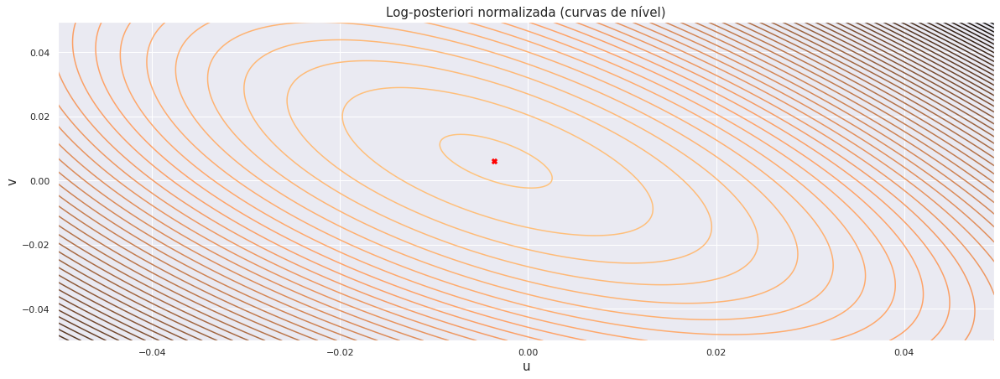

In [13]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



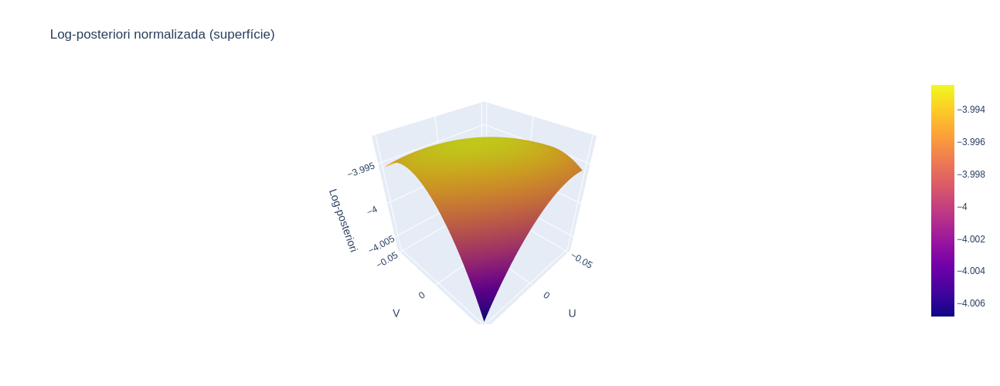

In [14]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [15]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])


def prior_pdf(X):
    """
        This method takes VECTOR value X and return SCALAR prior pdf evaluated at X.
    """
    return 1

def prior_pdf_derivative(X):
    """
        This method takes VECTOR value x and return VECTOR prior pdf derivative evaluated at X.
    """
    return np.zeros(
        shape=X.shape
    )

## 3.1. Standard Gradient

In [16]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [17]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 3700
Final log-posteriori: -39925.65231215294
----------------------------------------------------------------------------------------------------
CPU times: user 23min 31s, sys: 3min 21s, total: 26min 53s
Wall time: 20min 24s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

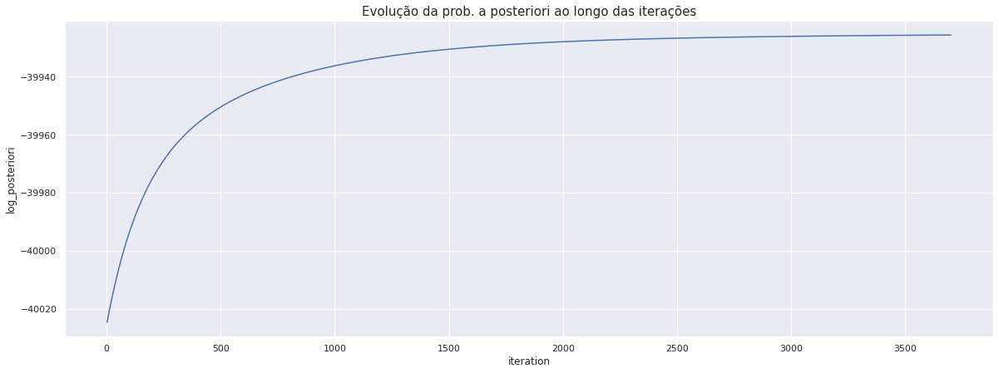

In [18]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

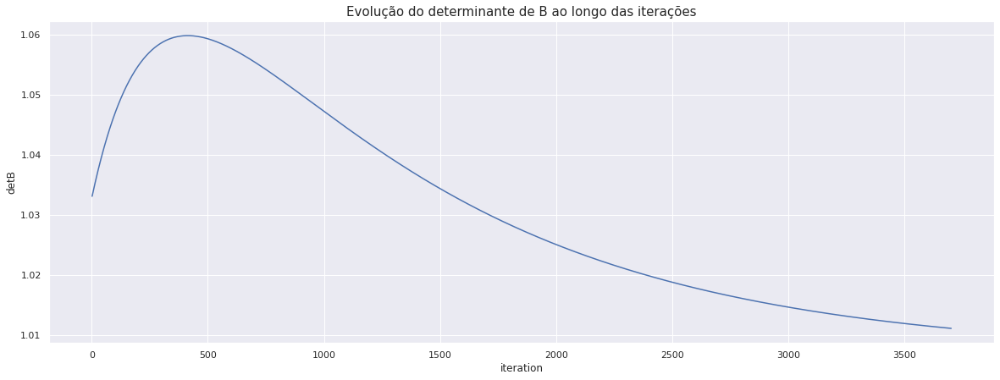

In [19]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

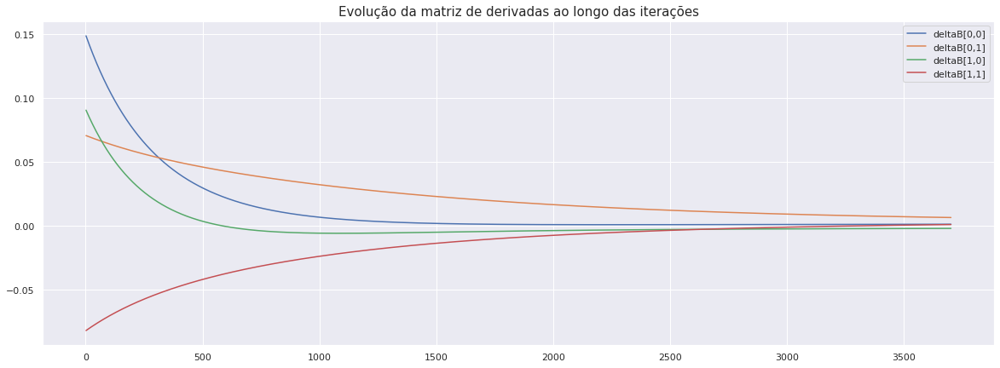

In [20]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [21]:
B

array([[ 0.48601819, -1.0538953 ],
       [ 0.52403165,  0.94410418]])

In [22]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

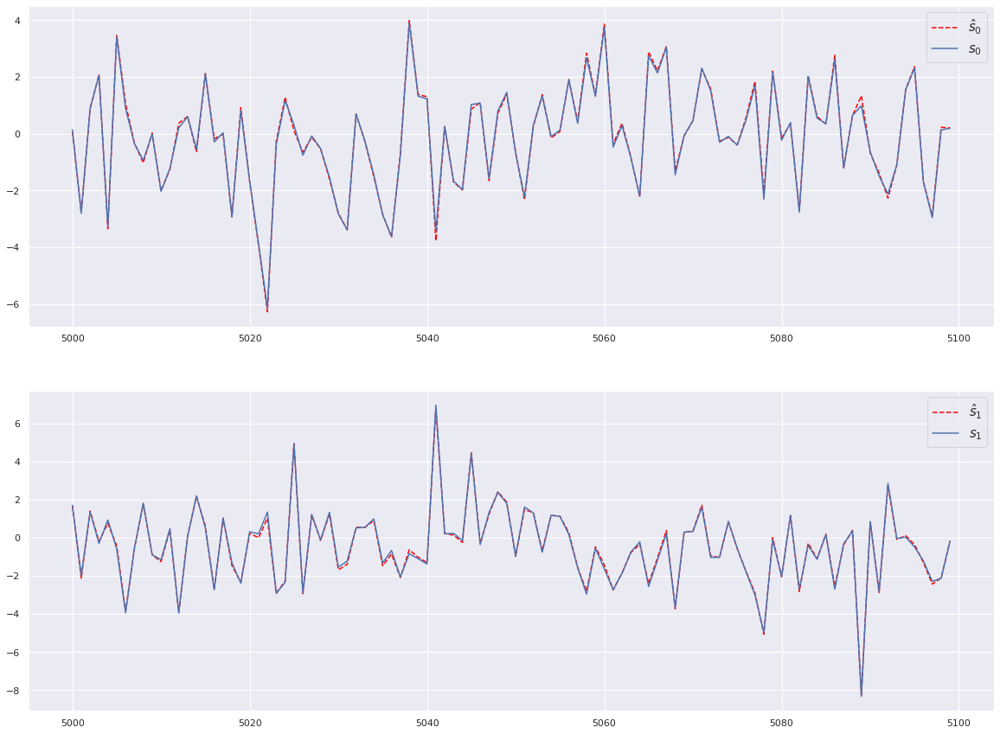

In [23]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [24]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.0006090251577063119


### 1.3.2. MAP - determinant equal to one
#### Prior:
#### $p(\boldsymbol{B}) \varpropto \exp \left[ -\frac{1}{2 \sigma^{2}} (det(\boldsymbol{B}) - 1)^2 \right]$

In [25]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    sig=0.1
    desired_det=1
    return (1/np.sqrt(2*np.pi*np.square(sig)))*np.exp(-np.square(np.linalg.det(B)-desired_det)/(2*np.square(sig)))

In [26]:
%%time

u_lims = (-0.05, 0.05)
v_lims = (-0.05, 0.05)
n_points = 251
central_point = [0, 0]

# Get step
u_step = (u_lims[-1] - u_lims[0])/(n_points-1)
v_step = (v_lims[-1] - v_lims[0])/(n_points-1)

# Step multipliers
step_multipliers = range(-(n_points-1)//2, (n_points-1)//2)

# Get u_vec and v_vec
u_vec = np.array([central_point[0] + s*u_step for s in step_multipliers])
v_vec = np.array([central_point[-1] + s*v_step for s in step_multipliers])

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

CPU times: user 1.61 s, sys: 140 ms, total: 1.75 s
Wall time: 19min 46s


In [27]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=-0.0036000000000000003, v=0.006
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

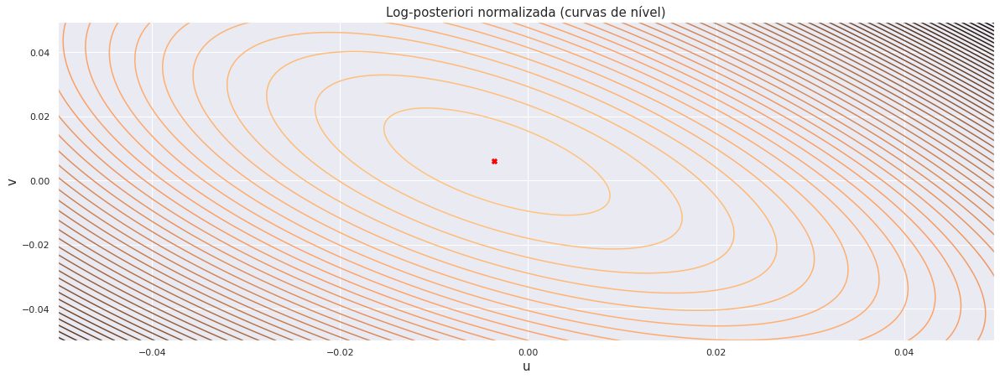

In [28]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



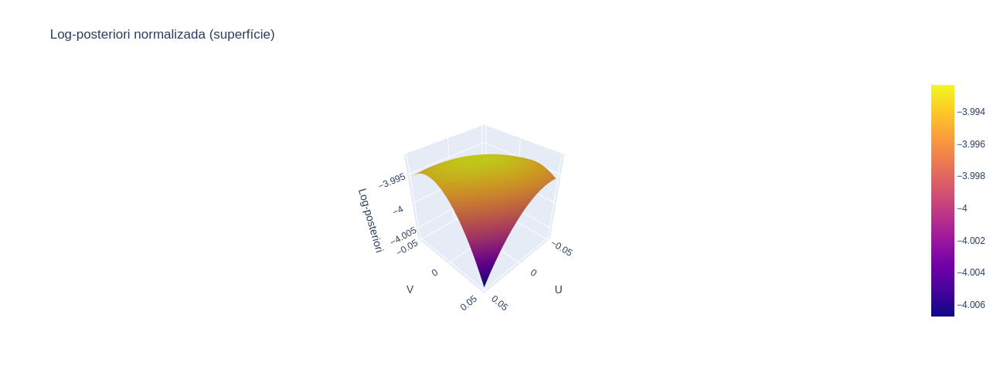

In [29]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [30]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])

def prior_pdf(X):
    sig=0.1
    desired_det=1
    return (1/np.sqrt(2*np.pi*np.square(sig)))*np.exp(-np.square(np.linalg.det(X)-desired_det)/(2*np.square(sig)))

def prior_pdf_derivative(X):
    sig=0.1
    return -1*prior_pdf(X)*(np.linalg.det(X)-1)/np.square(sig)

## 3.1. Standard Gradient

In [31]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [32]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 3714
Final log-posteriori: -39924.34020971472
----------------------------------------------------------------------------------------------------
CPU times: user 26min 28s, sys: 3min 18s, total: 29min 46s
Wall time: 23min 20s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

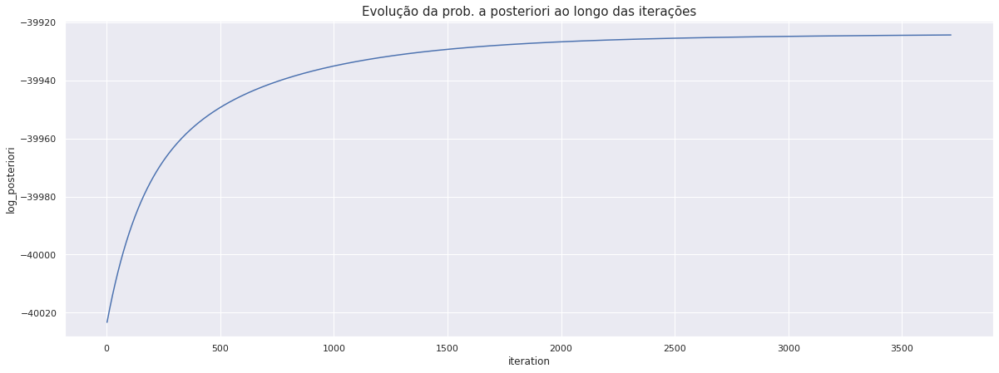

In [33]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

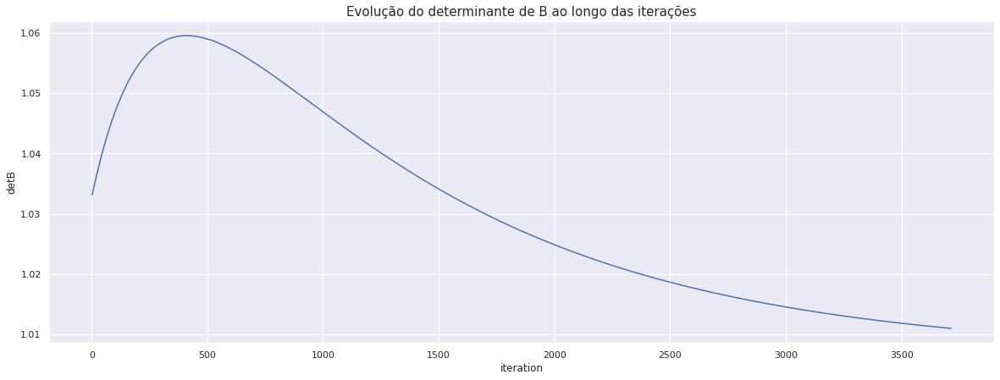

In [34]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

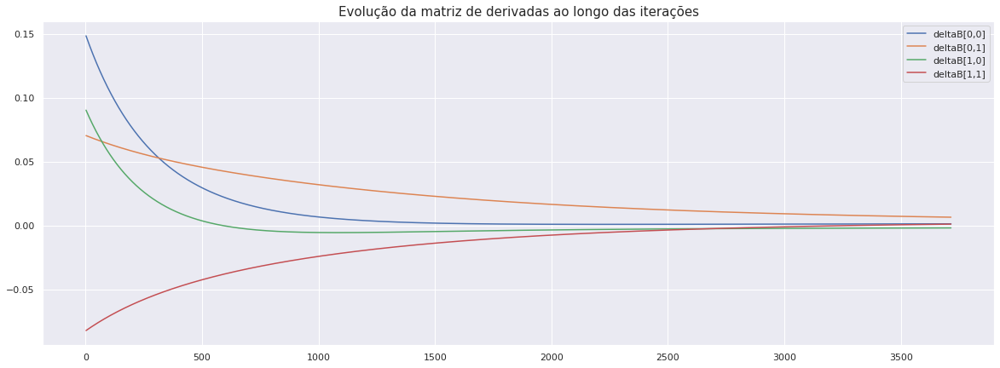

In [35]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [36]:
B

array([[ 0.4856303 , -1.05457859],
       [ 0.5243053 ,  0.94322969]])

In [37]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

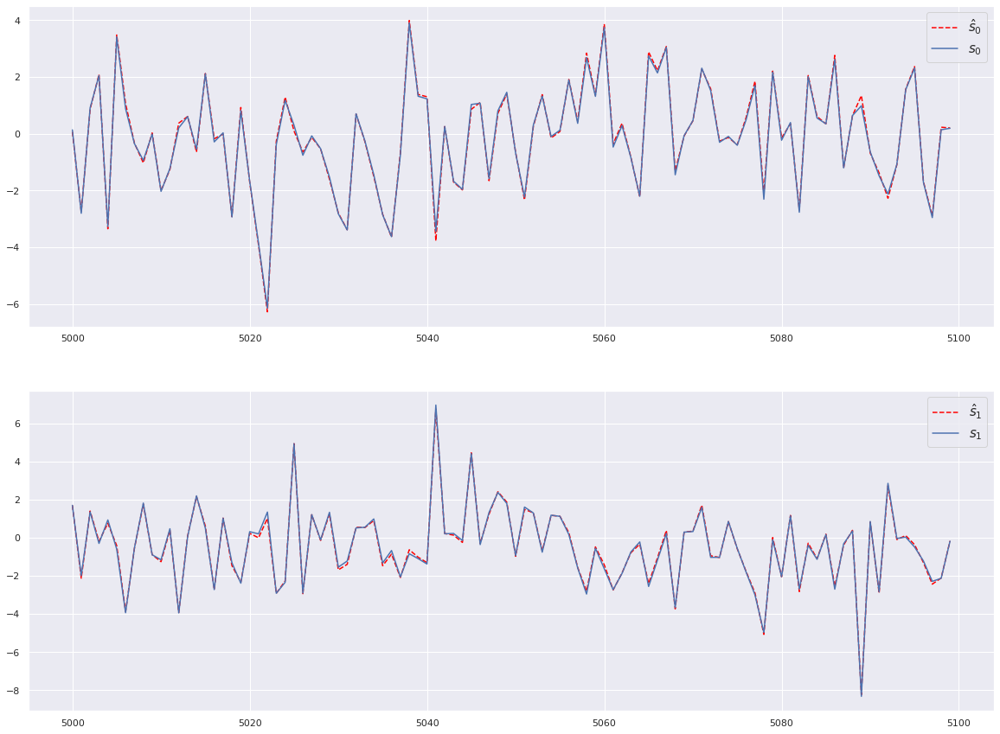

In [38]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [39]:
# SCATTER PLOT verdadeiro vs estimado

# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.0006179860287488588


## 1.3.3. MAP - near-identity transformation
#### Prior:
#### $p(\boldsymbol{B}) \varpropto \exp \left[ -\frac{1}{2 \sigma^{2}} ||\boldsymbol{B} - \boldsymbol{I}||^2 \right]$

In [40]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(X):
    sig=0.1
    return np.exp(
        (-1/2/np.square(sig))*np.linalg.norm(X-np.eye(X.shape[0]))
    )

In [41]:
%%time

u_lims = (-0.05, 0.05)
v_lims = (-0.05, 0.05)
n_points = 251
central_point = [0, 0]

# Get step
u_step = (u_lims[-1] - u_lims[0])/(n_points-1)
v_step = (v_lims[-1] - v_lims[0])/(n_points-1)

# Step multipliers
step_multipliers = range(-(n_points-1)//2, (n_points-1)//2)

# Get u_vec and v_vec
u_vec = np.array([central_point[0] + s*u_step for s in step_multipliers])
v_vec = np.array([central_point[-1] + s*v_step for s in step_multipliers])

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

CPU times: user 1.81 s, sys: 176 ms, total: 1.99 s
Wall time: 20min 47s


In [42]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=-0.005200000000000001, v=0.0076
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

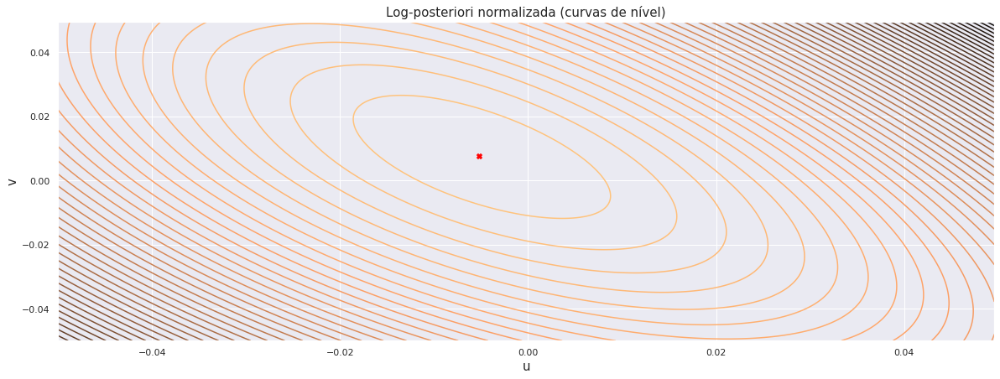

In [43]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



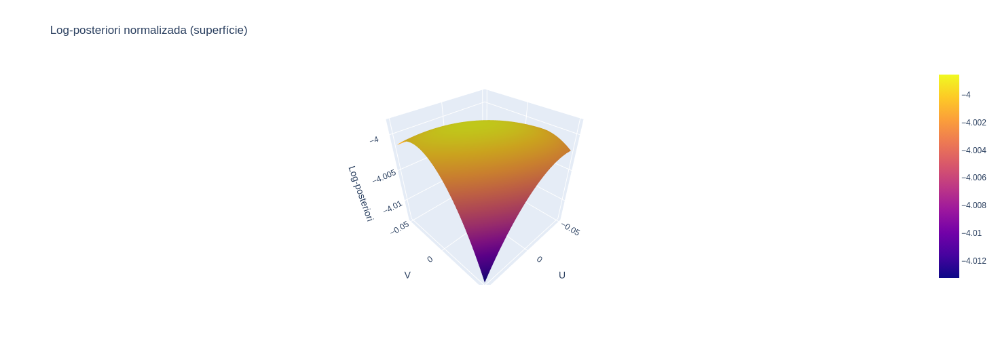

In [44]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [45]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])

def prior_pdf(X):
    sig=0.1
    return np.exp(
        (-1/2/np.square(sig))*np.linalg.norm(X-np.eye(X.shape[0]))
    )

def prior_pdf_derivative(X):
    sig=0.1
    der_X=np.empty(X.shape)
    I=np.eye(X.shape[0])
    for i, j in np.ndindex(X.shape):
        der_X[i, j] = prior_pdf(X)*(-1/np.square(sig))*(X[i,j]-I[i,j])
    return der_X

## 3.1. Standard Gradient

In [46]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [47]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 6926
Final log-posteriori: -39984.698086625445
----------------------------------------------------------------------------------------------------
CPU times: user 45min 34s, sys: 6min 14s, total: 51min 49s
Wall time: 39min 46s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

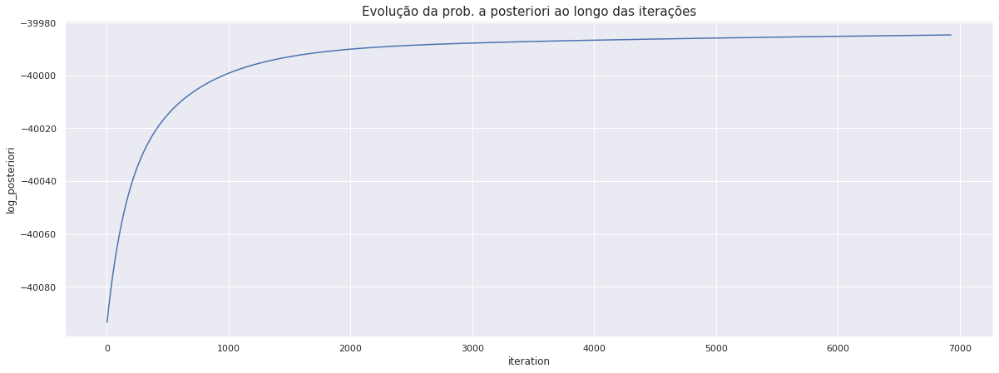

In [48]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

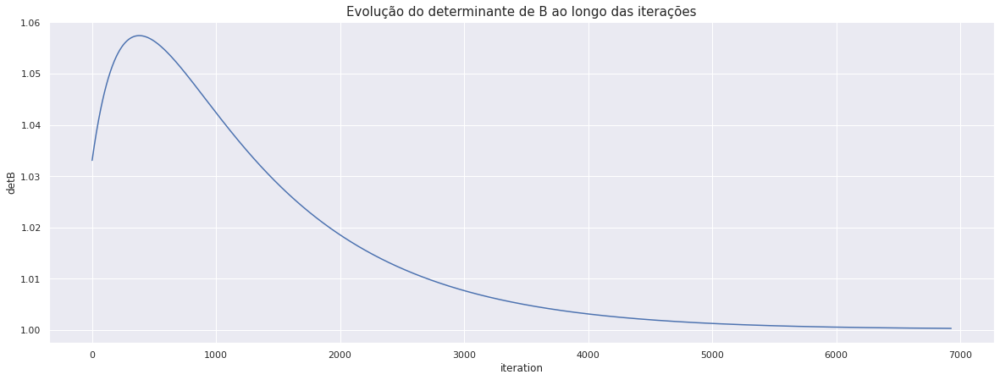

In [49]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

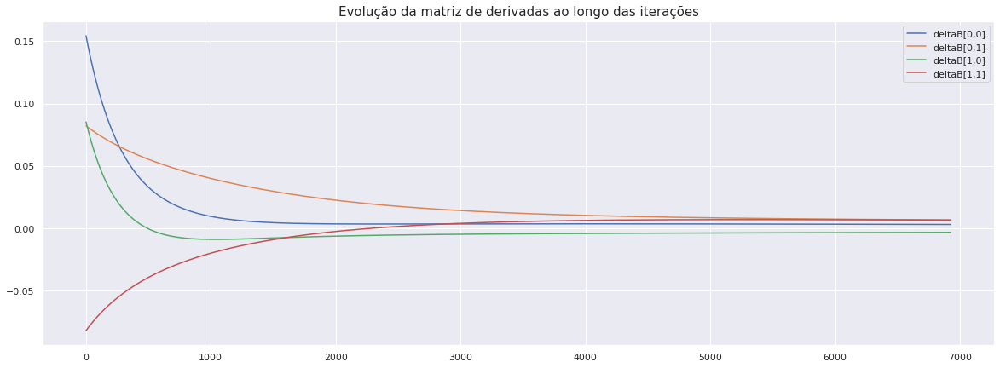

In [50]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [51]:
B

array([[ 0.50756324, -1.00186544],
       [ 0.50136257,  0.98118674]])

In [52]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

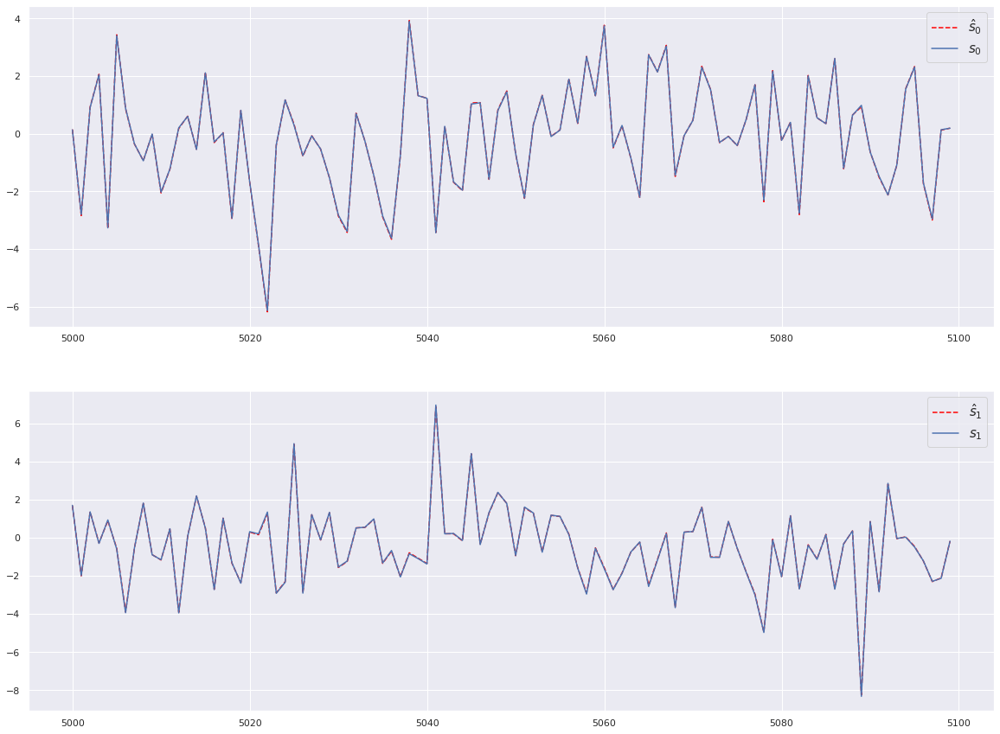

In [53]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [54]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.00015524201893414157


# 2. SLIGHTLY MISSPECIFIED MODEL

## 2.1. Initialize Sources

In [55]:
def source_cumulative(x):
    return 1/(1+np.exp(-x))

def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def source_generator(
    nsources,
    nobs,
    mu,
    scale
):
    return np.random.logistic(
        loc=mu,
        scale=scale,
        size=(nsources, nobs)
    )

In [56]:
NSOURCES=2
NOBS=7500
MU=0.1
SCALE=1.1

s = source_generator(
    nsources=NSOURCES,
    nobs=NOBS,
    mu=MU,
    scale=SCALE
)

print('-'*100)
print('NÚMERO DE FONTES: {}'.format(NSOURCES))
print('TAMANHO DOS SINAIS DAS FONTES: {}'.format(NOBS))
for i in range(s.shape[0]):
    print(
        'CURTOSE s{}: {}'.format(
            i,
            st.kurtosis(a=s[i,:])
        )
    )
    
print('-'*100)

----------------------------------------------------------------------------------------------------
NÚMERO DE FONTES: 2
TAMANHO DOS SINAIS DAS FONTES: 7500
CURTOSE s0: 1.2718964379009572
CURTOSE s1: 1.2297013264888292
----------------------------------------------------------------------------------------------------


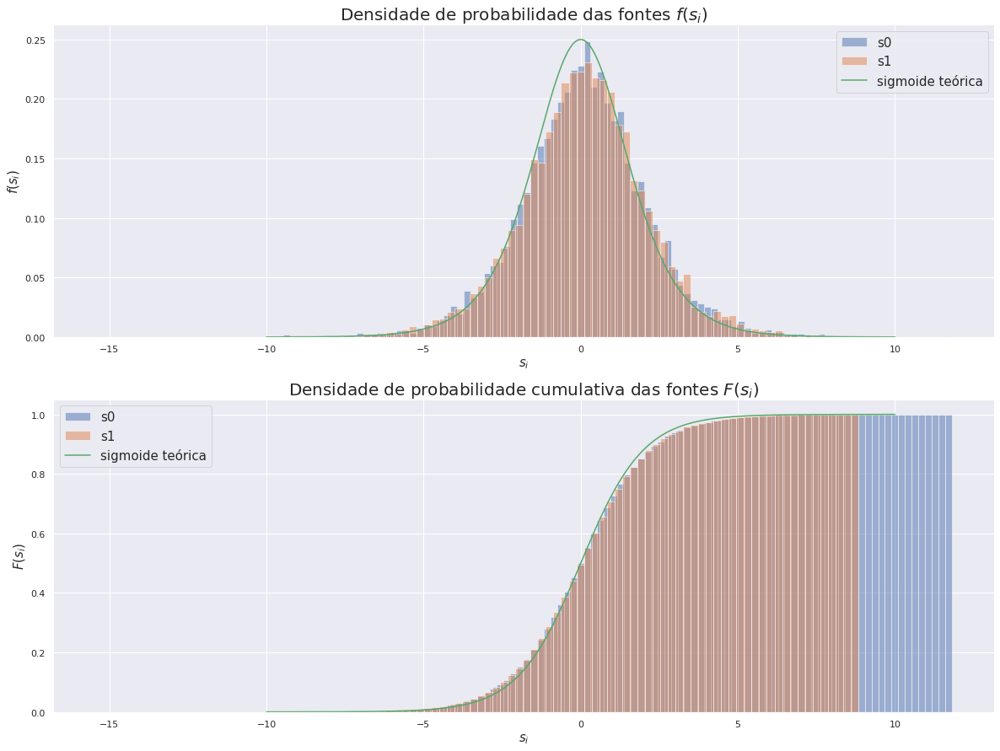

In [57]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)


for i in range(1, NSOURCES+1):
    ax1.hist(
        x=s[i-1,:],
        bins=100,
        density=True,
        label='s{}'.format(i-1),
        alpha=0.5
    )
    ax2.hist(
        x=s[i-1,:],
        bins=100,
        cumulative=True,
        density=True,
        label='s{}'.format(i-1),
        alpha=0.5
    )
    
ax1.plot(
    np.linspace(-10,10,1000),
    [source_pdf(x) for x in np.linspace(-10,10,1000)],
    label='sigmoide teórica'
)


ax2.plot(
    np.linspace(-10,10,1000),
    [source_cumulative(x) for x in np.linspace(-10,10,1000)],
    label='sigmoide teórica'
)

ax1.set_xlabel(
    '$s_{i}$',
    fontsize=15
)
ax1.set_ylabel(
    '$f(s_{i})$',
    fontsize=15
)
ax1.set_title(
    'Densidade de probabilidade das fontes $f(s_{i})$',
    fontsize=20
)

ax2.set_xlabel(
    '$s_{i}$',
    fontsize=15
)
ax2.set_ylabel(
    '$F(s_{i})$',
    fontsize=15
)
ax2.set_title(
    'Densidade de probabilidade cumulativa das fontes $F(s_{i})$',
    fontsize=20
)

l1=ax1.legend(fontsize=15)
l2=ax2.legend(fontsize=15)

## 2.2. Mix sources and generate observations

In [58]:
# Mixing matrix
A = np.array([
    [1, 1],
    [-0.5, 0.5]
])
print('MIXING MATRIX A:')
print(A)

MIXING MATRIX A:
[[ 1.   1. ]
 [-0.5  0.5]]


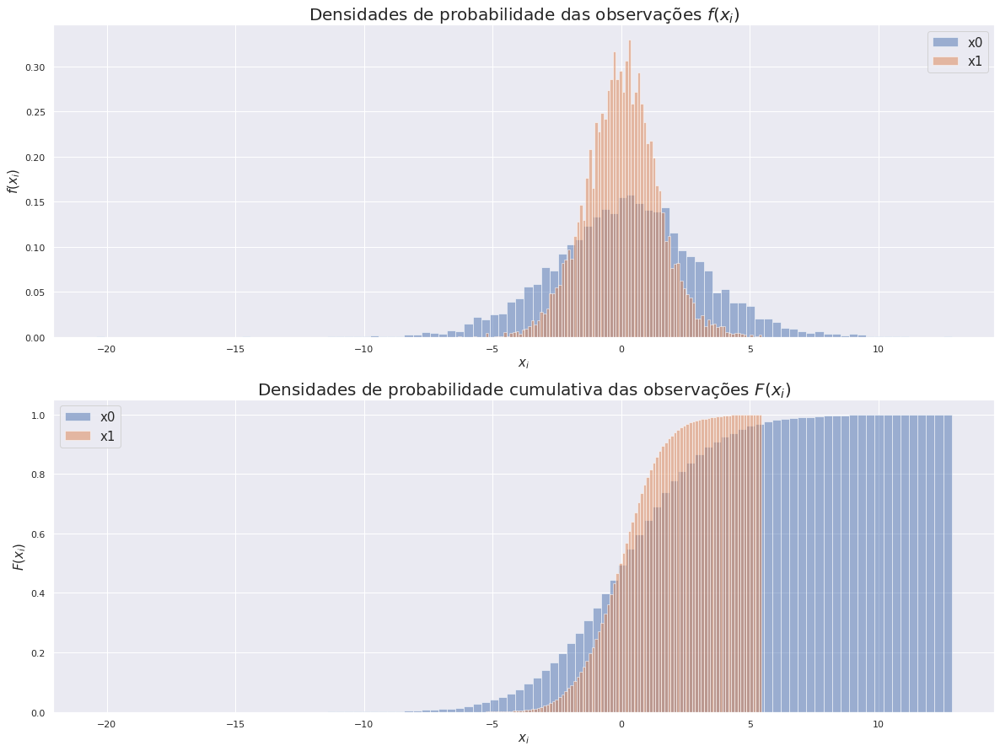

In [59]:
# Observed sources
x = A@s

fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)

for i in range(1, NSOURCES+1):
    ax1.hist(
        x=x[i-1,:],
        bins=100,
        density=True,
        label='x{}'.format(i-1),
        alpha=0.5
    )
    ax2.hist(
        x=x[i-1,:],
        bins=100,
        cumulative=True,
        density=True,
        label='x{}'.format(i-1),
        alpha=0.5
    )

ax1.set_xlabel(
    '$x_{i}$',
    fontsize=15
)
ax1.set_ylabel(
    '$f(x_{i})$',
    fontsize=15
)
ax1.set_title(
    'Densidades de probabilidade das observações $f(x_{i})$',
    fontsize=20
)

ax2.set_xlabel(
    '$x_{i}$',
    fontsize=15
)
ax2.set_ylabel(
    '$F(x_{i})$',
    fontsize=15
)
ax2.set_title(
    'Densidades de probabilidade cumulativa das observações $F(x_{i})$',
    fontsize=20
)

l1=ax1.legend(fontsize=15)
l2=ax2.legend(fontsize=15)

## 2.3. Performance Curves

In [60]:
def get_posteriori_neighborhood(
    A,
    x,
    T,
    u_vec,
    v_vec,
    n_points,
    source_pdf_fn,
    prior_pdf_fn,
    njobs=1
):
    
    def __get_posteriori(
        A,
        x,
        T,
        source_pdf_fn,
        prior_pdf_fn,
        idx_info
    ):
        i, u = idx_info[0]
        j, v = idx_info[-1]
        
        A_shifted = A + u*symmetric_basis + v*skew_symmetric_basis
        
        B = np.linalg.inv(A_shifted)
        
        likelihood = np.log(np.abs(np.linalg.det(B)))
        
        likelihood_iterator = [
            (t,i) for t,i in itertools.product(
                range(x.shape[-1]),
                range(x.shape[0]))
        ]

        s_est = B@x

        likelihood += (1/T)*np.sum([
            np.log(source_pdf_fn(s_est[i,t])) for t,i in likelihood_iterator
        ])
        
        prior = np.log(prior_pdf_fn(B))/T
        
        return {
            'i': i,
            'j': j,
            'log_posteriori': likelihood + prior
        }
        

    symmetric_basis = np.array([
        [0, 1],
        [1, 0]
    ])

    skew_symmetric_basis = np.array([
        [0, -1],
        [1, 0]
    ])
    
    iterator = itertools.product(
        enumerate(u_vec),
        enumerate(v_vec)
    )
    # it = [x for x in iterator]
    
    exec_fn = partial(
        __get_posteriori,
        A,
        x,
        T,
        source_pdf_fn,
        prior_pdf_fn
    )
    
    z = np.empty(
        shape=(
            u_vec.shape[0],
            v_vec.shape[0]
        )
    )
    with pathos.multiprocessing.ProcessingPool(njobs) as p:
        results = p.map(exec_fn, iterator)
    
    for r in results:
        i=r['i']
        j=r['j']
        z[i, j]=r['log_posteriori']
    
    return z

### 2.3.1. Likelihood

In [61]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    return 1

In [62]:
%%time

u_lims = (-0.3, 0.3)
v_lims = (-0.3, 0.3)
n_points = 200

u_vec = np.linspace(u_lims[0], u_lims[-1], n_points)
v_vec = np.linspace(v_lims[0], v_lims[-1], n_points)

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

CPU times: user 1.25 s, sys: 46.1 ms, total: 1.29 s
Wall time: 9min 37s


In [63]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=0.055778894472361784, v=-0.1492462311557789
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

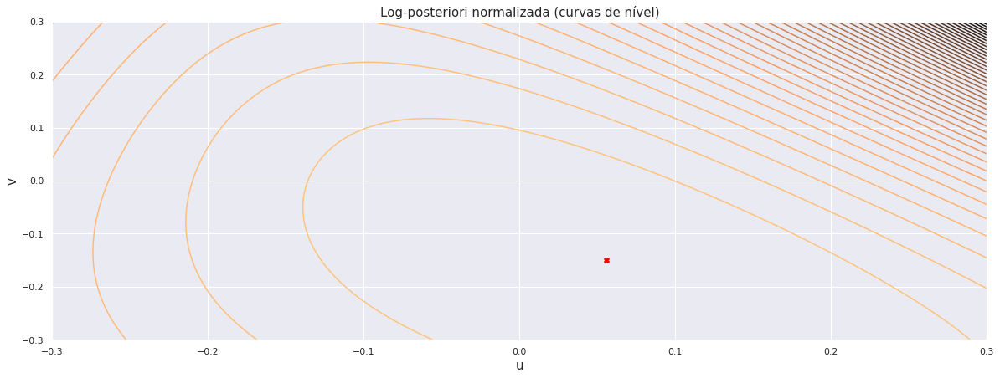

In [64]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



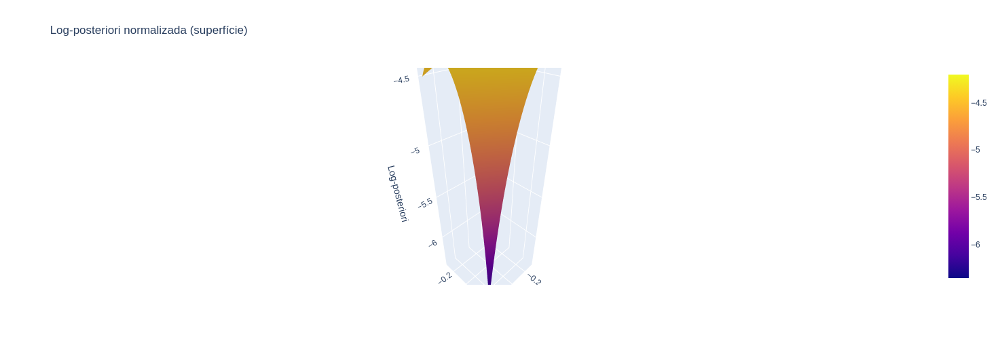

In [65]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [66]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])


def prior_pdf(X):
    """
        This method takes VECTOR value X and return SCALAR prior pdf evaluated at X.
    """
    return 1

def prior_pdf_derivative(X):
    """
        This method takes VECTOR value x and return VECTOR prior pdf derivative evaluated at X.
    """
    return np.zeros(
        shape=X.shape
    )

## 3.1. Standard Gradient

In [67]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [68]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 3621
Final log-posteriori: -31508.75193057853
----------------------------------------------------------------------------------------------------
CPU times: user 20min 44s, sys: 3min 14s, total: 23min 58s
Wall time: 17min 42s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

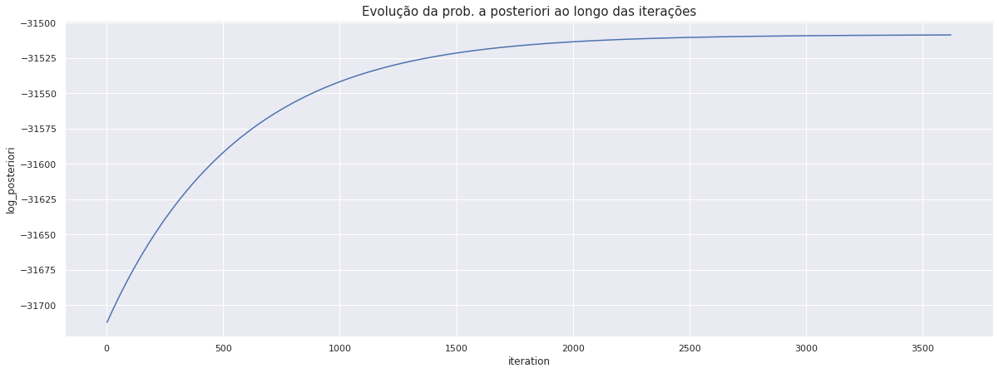

In [69]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

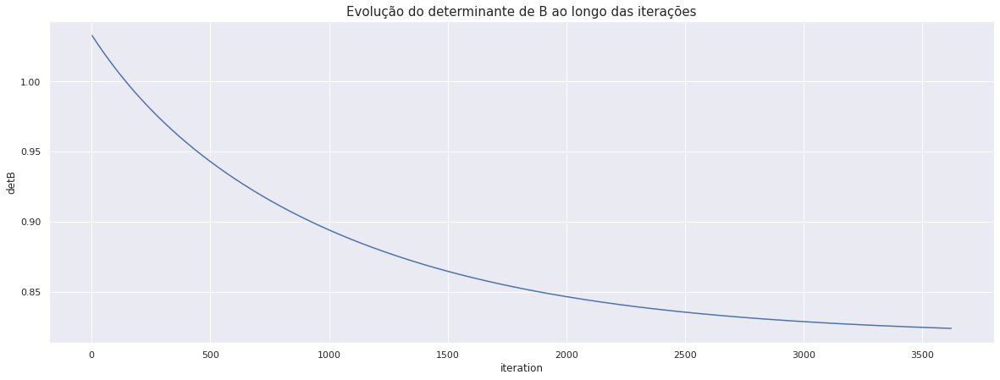

In [70]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

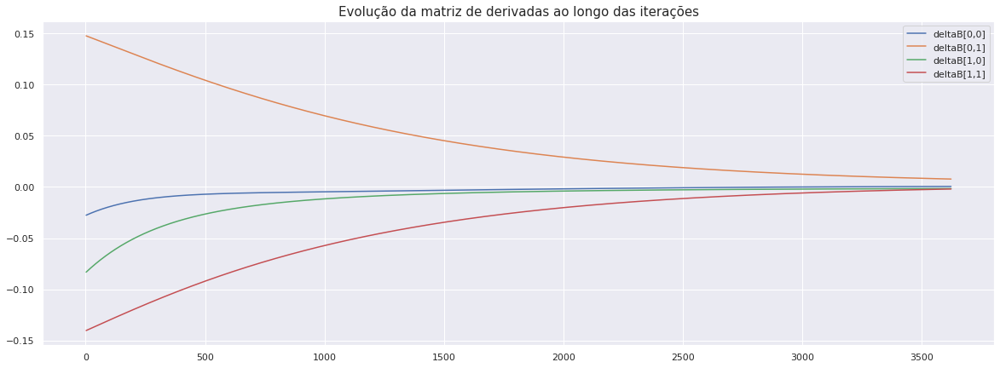

In [71]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [72]:
B

array([[ 0.42398145, -0.9650854 ],
       [ 0.47453864,  0.86270222]])

In [73]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

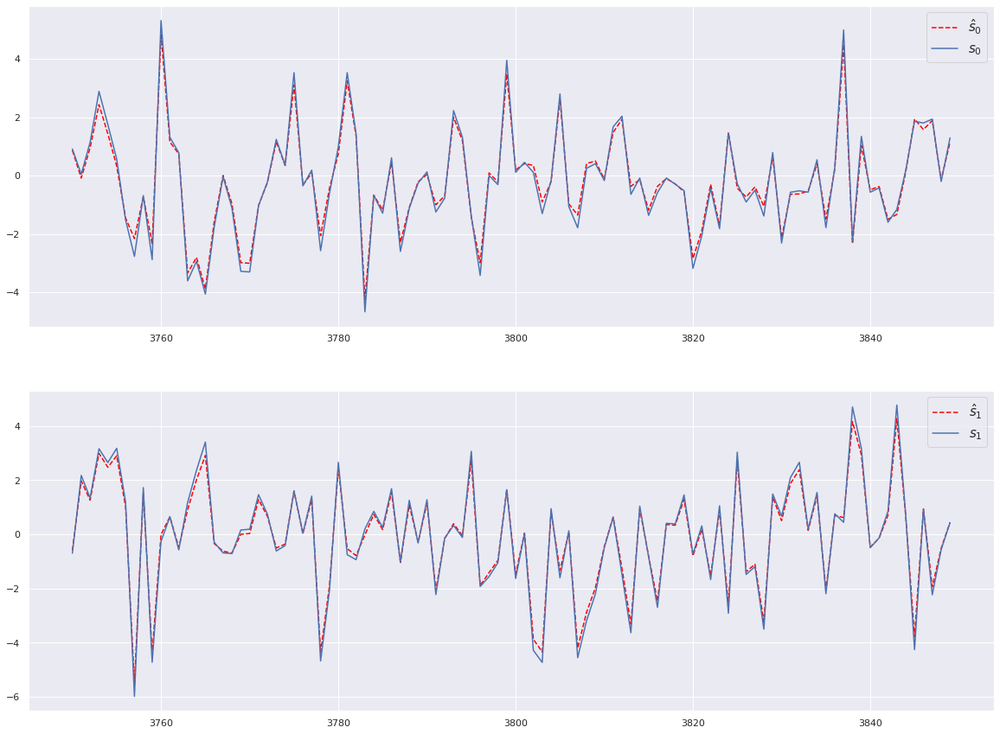

In [74]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [75]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.0017527322277779728


### 2.3.2. MAP - determinant equal to one

In [76]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    sig=0.1
    desired_det=1
    return (1/np.sqrt(2*np.pi*np.square(sig)))*np.exp(-np.square(np.linalg.det(B)-desired_det)/(2*np.square(sig)))

In [77]:
%%time

u_lims = (-0.3, 0.3)
v_lims = (-0.3, 0.3)
n_points = 200

u_vec = np.linspace(u_lims[0], u_lims[-1], n_points)
v_vec = np.linspace(v_lims[0], v_lims[-1], n_points)

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

CPU times: user 1.45 s, sys: 335 ms, total: 1.78 s
Wall time: 12min 23s


In [78]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=0.05276381909547739, v=-0.14623115577889448
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

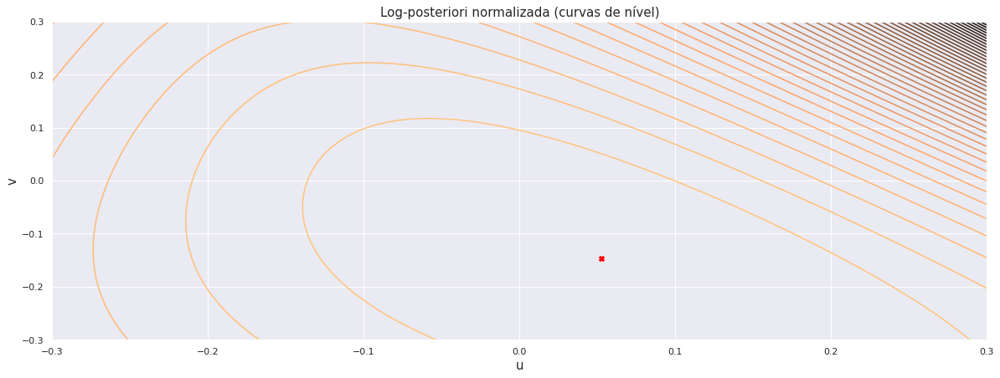

In [79]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



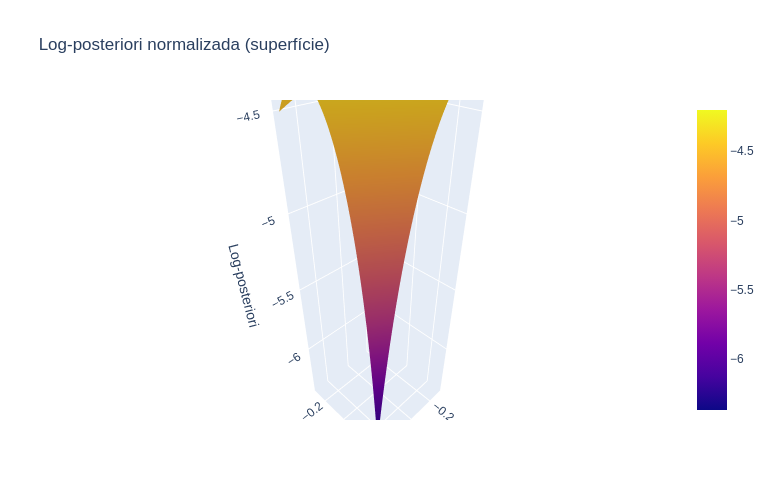

In [80]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [81]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])

def prior_pdf(X):
    sig=0.1
    desired_det=1
    return (1/np.sqrt(2*np.pi*np.square(sig)))*np.exp(-np.square(np.linalg.det(X)-desired_det)/(2*np.square(sig)))

def prior_pdf_derivative(X):
    sig=0.1
    return -1*prior_pdf(X)*(np.linalg.det(X)-1)/np.square(sig)

## 3.1. Standard Gradient

In [82]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [83]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 3561
Final log-posteriori: -31508.759143928924
----------------------------------------------------------------------------------------------------
CPU times: user 21min 41s, sys: 3min 8s, total: 24min 49s
Wall time: 18min 41s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

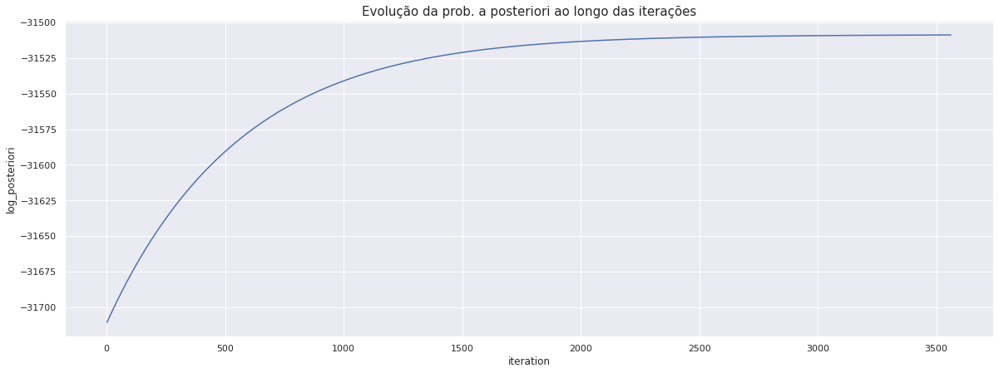

In [84]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

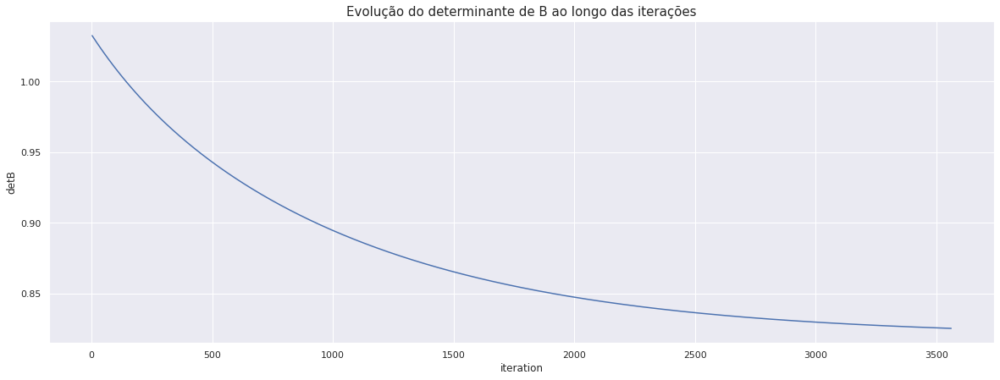

In [85]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

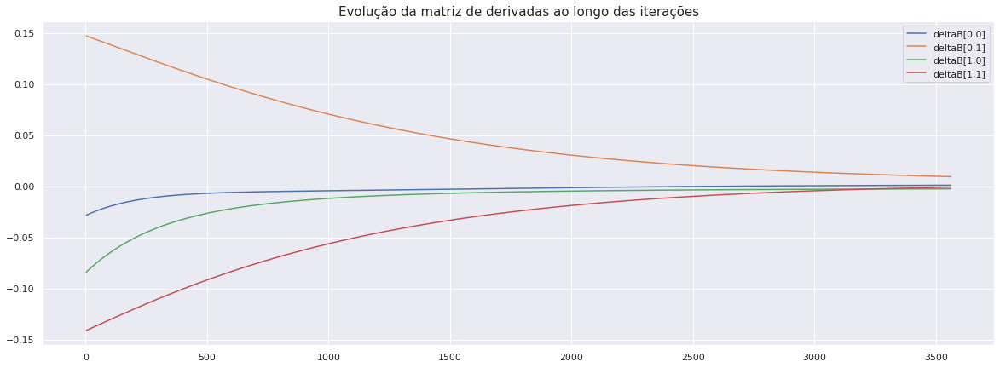

In [86]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [87]:
B

array([[ 0.42621741, -0.96127562],
       [ 0.47367341,  0.86770686]])

In [88]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

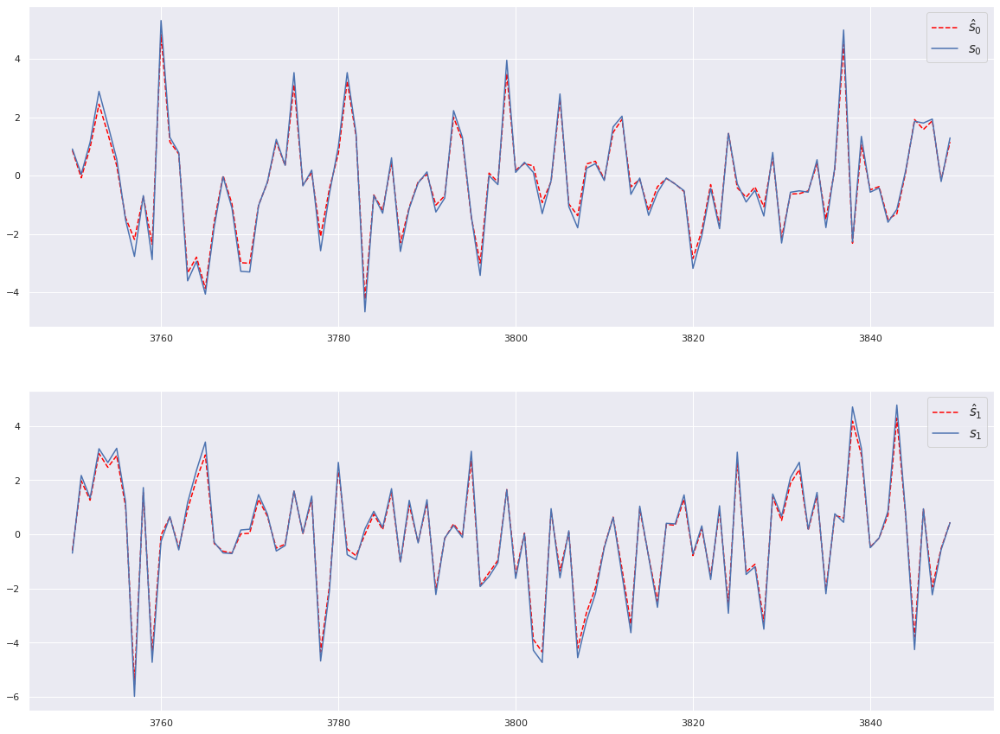

In [89]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [90]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.0017096813766631503


## 2.3.3. MAP - near-identity transformation

In [91]:
def source_pdf(x):
    return 0.5*np.exp(-np.abs(x))
    # return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    sig=0.1
    return np.exp(
        (-1/2/np.square(sig))*np.square(np.linalg.norm(B-np.eye(B.shape[0])))
    )

In [92]:
%%time

u_lims = (-0.5, 0.5)
v_lims = (-0.5, 0.5)
n_points = 200

u_vec = np.linspace(u_lims[0], u_lims[-1], n_points)
v_vec = np.linspace(v_lims[0], v_lims[-1], n_points)

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

LinAlgError: Singular matrix

In [93]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=0.0879396984924623, v=-0.24371859296482412
----------------------------------------------------------------------------------------------------


In [94]:
max_post_point

(117, 51)

Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

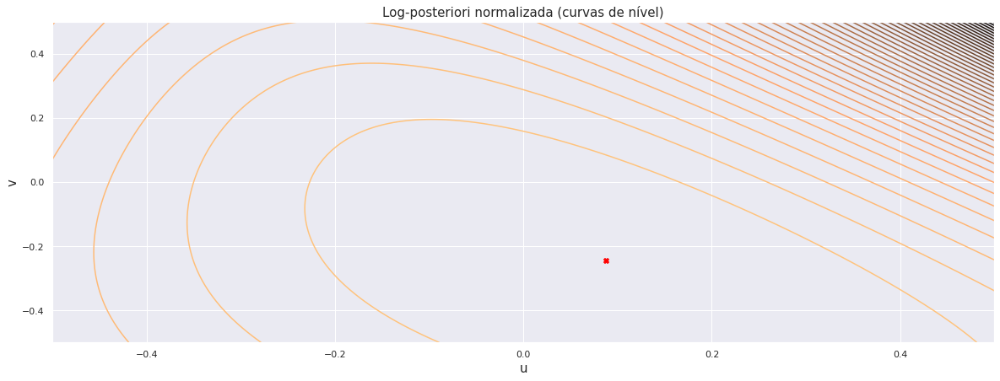

In [95]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



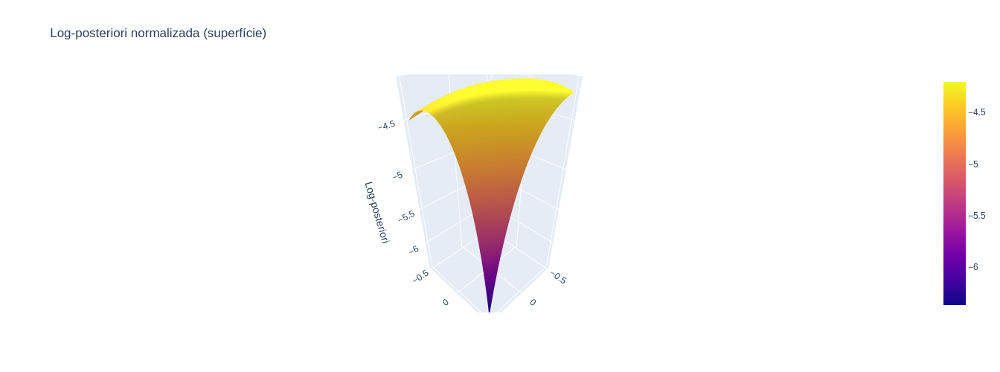

In [96]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [97]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])

def prior_pdf(X):
    sig=0.1
    return np.exp(
        (-1/2/np.square(sig))*np.linalg.norm(X-np.eye(X.shape[0]))
    )

def prior_pdf_derivative(X):
    sig=0.1
    der_X=np.empty(X.shape)
    I=np.eye(X.shape[0])
    for i, j in np.ndindex(X.shape):
        der_X[i, j] = prior_pdf(X)*(-1/np.square(sig))*(X[i,j]-I[i,j])
    return der_X

## 3.1. Standard Gradient

In [98]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [99]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 4190
Final log-posteriori: -31567.15416747123
----------------------------------------------------------------------------------------------------
CPU times: user 21min 4s, sys: 3min 46s, total: 24min 50s
Wall time: 17min 33s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

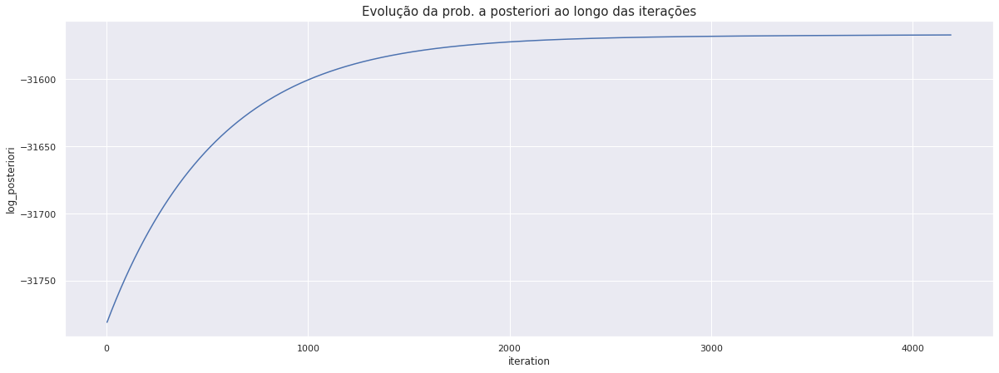

In [100]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

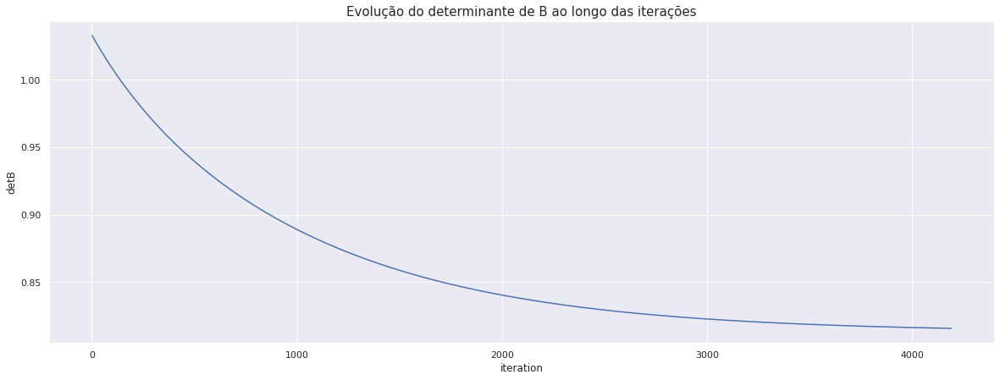

In [101]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

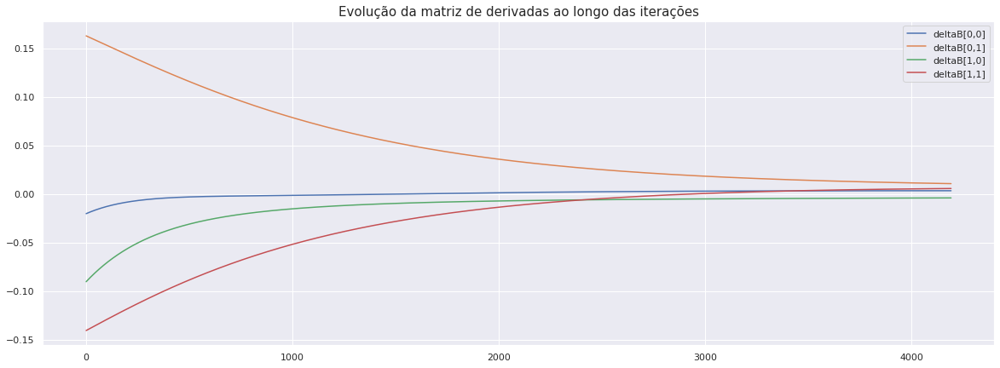

In [102]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [103]:
B

array([[ 0.43895287, -0.92856308],
       [ 0.4596433 ,  0.88590361]])

In [104]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

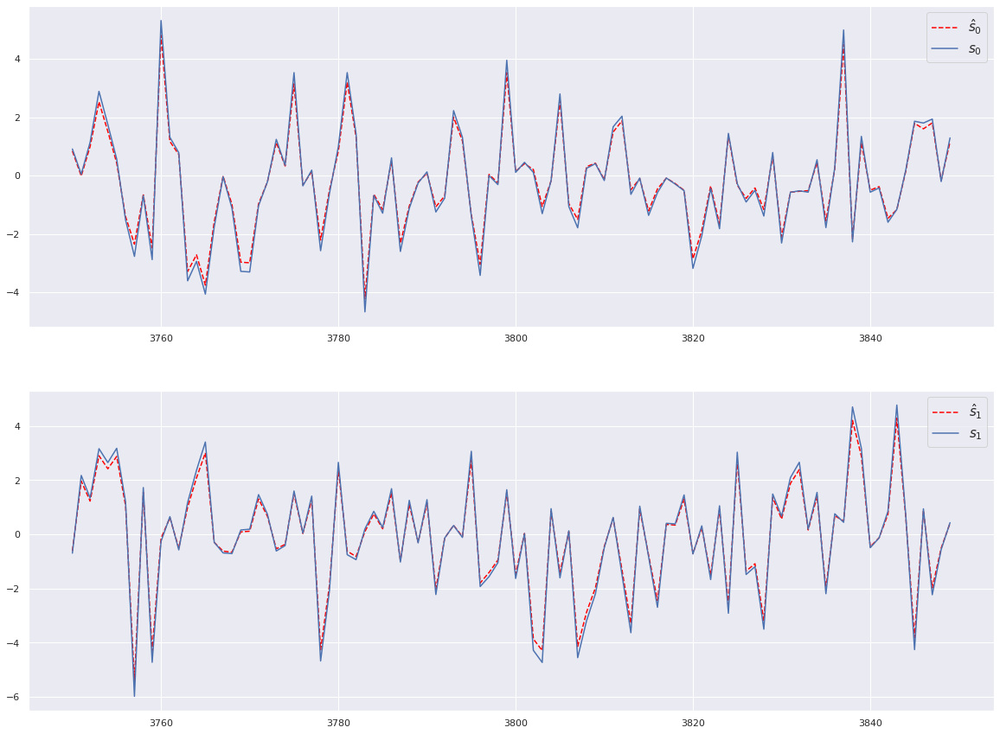

In [105]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [106]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.0016288898959477957


# 3. MORE MISSPECIFIED MODEL

## 3.1. Initialize Sources

In [107]:
def source_cumulative(x):
    return 1/(1+np.exp(-x))

def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def source_generator(
    nsources,
    nobs,
    mu,
    scale
):
    return np.random.logistic(
        loc=mu,
        scale=scale,
        size=(nsources, nobs)
    )

In [108]:
NSOURCES=2
NOBS=7500
MU=0.5
SCALE=1.5

s = source_generator(
    nsources=NSOURCES,
    nobs=NOBS,
    mu=MU,
    scale=SCALE
)

print('-'*100)
print('NÚMERO DE FONTES: {}'.format(NSOURCES))
print('TAMANHO DOS SINAIS DAS FONTES: {}'.format(NOBS))
for i in range(s.shape[0]):
    print(
        'CURTOSE s{}: {}'.format(
            i,
            st.kurtosis(a=s[i,:])
        )
    )
    
print('-'*100)

----------------------------------------------------------------------------------------------------
NÚMERO DE FONTES: 2
TAMANHO DOS SINAIS DAS FONTES: 7500
CURTOSE s0: 1.2352238713024697
CURTOSE s1: 1.1583051619319455
----------------------------------------------------------------------------------------------------


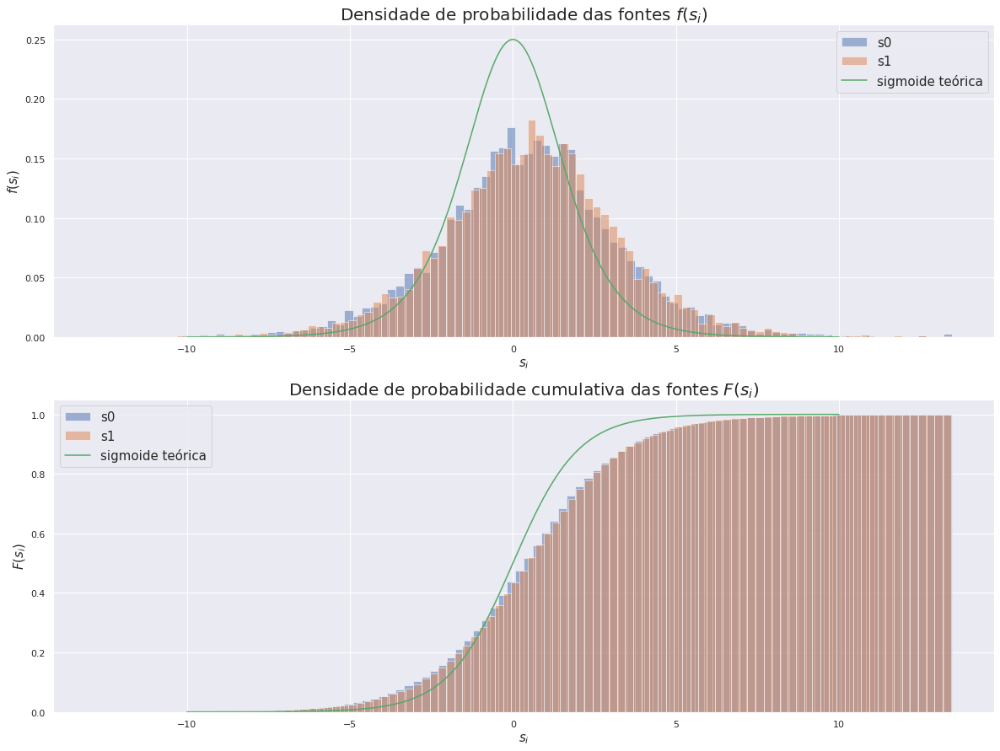

In [109]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)


for i in range(1, NSOURCES+1):
    ax1.hist(
        x=s[i-1,:],
        bins=100,
        density=True,
        label='s{}'.format(i-1),
        alpha=0.5
    )
    ax2.hist(
        x=s[i-1,:],
        bins=100,
        cumulative=True,
        density=True,
        label='s{}'.format(i-1),
        alpha=0.5
    )
    
ax1.plot(
    np.linspace(-10,10,1000),
    [source_pdf(x) for x in np.linspace(-10,10,1000)],
    label='sigmoide teórica'
)


ax2.plot(
    np.linspace(-10,10,1000),
    [source_cumulative(x) for x in np.linspace(-10,10,1000)],
    label='sigmoide teórica'
)

ax1.set_xlabel(
    '$s_{i}$',
    fontsize=15
)
ax1.set_ylabel(
    '$f(s_{i})$',
    fontsize=15
)
ax1.set_title(
    'Densidade de probabilidade das fontes $f(s_{i})$',
    fontsize=20
)

ax2.set_xlabel(
    '$s_{i}$',
    fontsize=15
)
ax2.set_ylabel(
    '$F(s_{i})$',
    fontsize=15
)
ax2.set_title(
    'Densidade de probabilidade cumulativa das fontes $F(s_{i})$',
    fontsize=20
)

l1=ax1.legend(fontsize=15)
l2=ax2.legend(fontsize=15)

## 2.2. Mix sources and generate observations

In [110]:
# Mixing matrix
A = np.array([
    [1, 1],
    [-0.5, 0.5]
])
print('MIXING MATRIX A:')
print(A)

MIXING MATRIX A:
[[ 1.   1. ]
 [-0.5  0.5]]


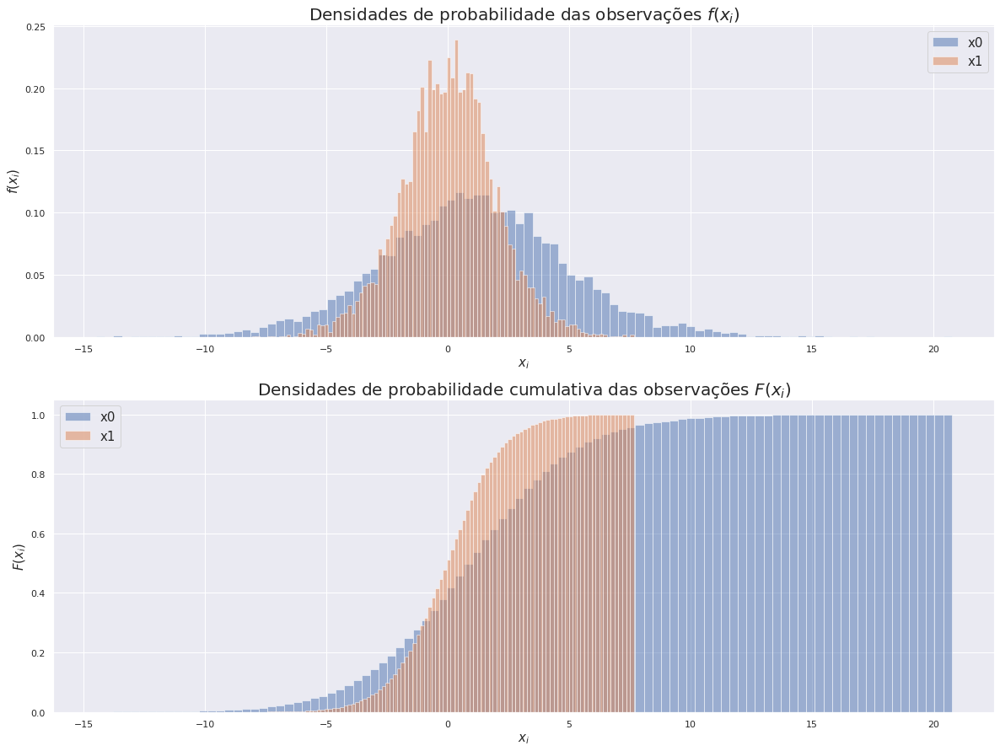

In [111]:
# Observed sources
x = A@s

fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)

for i in range(1, NSOURCES+1):
    ax1.hist(
        x=x[i-1,:],
        bins=100,
        density=True,
        label='x{}'.format(i-1),
        alpha=0.5
    )
    ax2.hist(
        x=x[i-1,:],
        bins=100,
        cumulative=True,
        density=True,
        label='x{}'.format(i-1),
        alpha=0.5
    )

ax1.set_xlabel(
    '$x_{i}$',
    fontsize=15
)
ax1.set_ylabel(
    '$f(x_{i})$',
    fontsize=15
)
ax1.set_title(
    'Densidades de probabilidade das observações $f(x_{i})$',
    fontsize=20
)

ax2.set_xlabel(
    '$x_{i}$',
    fontsize=15
)
ax2.set_ylabel(
    '$F(x_{i})$',
    fontsize=15
)
ax2.set_title(
    'Densidades de probabilidade cumulativa das observações $F(x_{i})$',
    fontsize=20
)

l1=ax1.legend(fontsize=15)
l2=ax2.legend(fontsize=15)

## 2.3. Performance Curves

In [112]:
def get_posteriori_neighborhood(
    A,
    x,
    T,
    u_vec,
    v_vec,
    n_points,
    source_pdf_fn,
    prior_pdf_fn,
    njobs=1
):
    
    def __get_posteriori(
        A,
        x,
        T,
        source_pdf_fn,
        prior_pdf_fn,
        idx_info
    ):
        i, u = idx_info[0]
        j, v = idx_info[-1]
        
        A_shifted = A + u*symmetric_basis + v*skew_symmetric_basis
        
        B = np.linalg.inv(A_shifted)
        
        likelihood = np.log(np.abs(np.linalg.det(B)))
        
        likelihood_iterator = [
            (t,i) for t,i in itertools.product(
                range(x.shape[-1]),
                range(x.shape[0]))
        ]

        s_est = B@x

        likelihood += (1/T)*np.sum([
            np.log(source_pdf_fn(s_est[i,t])) for t,i in likelihood_iterator
        ])
        
        prior = np.log(prior_pdf_fn(B))/T
        
        return {
            'i': i,
            'j': j,
            'log_posteriori': likelihood + prior
        }
        

    symmetric_basis = np.array([
        [0, 1],
        [1, 0]
    ])

    skew_symmetric_basis = np.array([
        [0, -1],
        [1, 0]
    ])
    
    iterator = itertools.product(
        enumerate(u_vec),
        enumerate(v_vec)
    )
    # it = [x for x in iterator]
    
    exec_fn = partial(
        __get_posteriori,
        A,
        x,
        T,
        source_pdf_fn,
        prior_pdf_fn
    )
    
    z = np.empty(
        shape=(
            u_vec.shape[0],
            v_vec.shape[0]
        )
    )
    with pathos.multiprocessing.ProcessingPool(njobs) as p:
        results = p.map(exec_fn, iterator)
    
    for r in results:
        i=r['i']
        j=r['j']
        z[i, j]=r['log_posteriori']
    
    return z

### 2.3.1. Likelihood

In [113]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    return 1

In [114]:
%%time

u_lims = (-1, 1)
v_lims = (-1, 1)
n_points = 200

u_vec = np.linspace(u_lims[0], u_lims[-1], n_points)
v_vec = np.linspace(v_lims[0], v_lims[-1], n_points)

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

LinAlgError: Singular matrix

In [115]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=0.1758793969849246, v=-0.48743718592964824
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

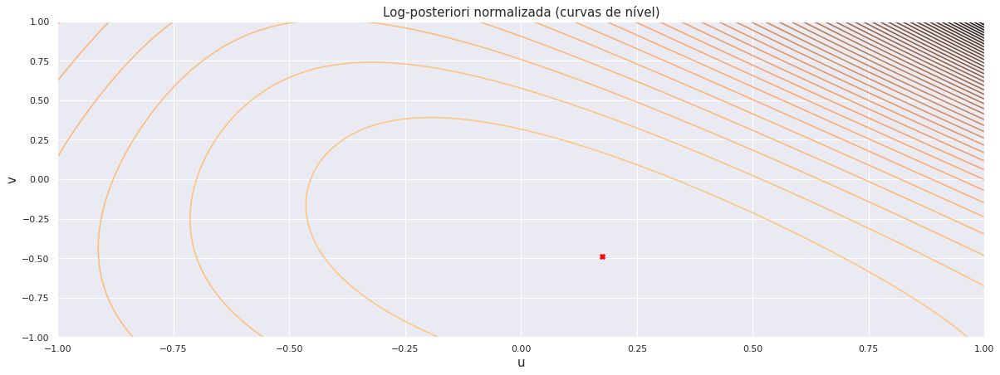

In [116]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



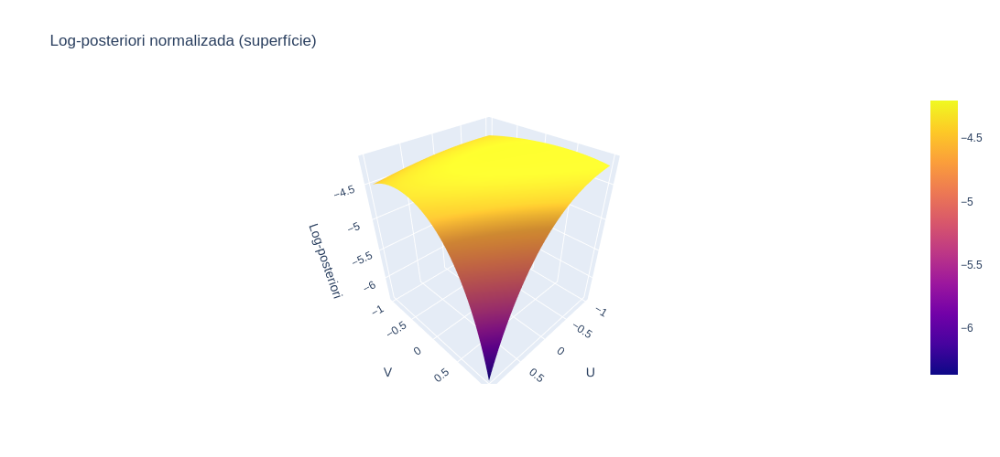

In [117]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [118]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])


def prior_pdf(X):
    """
        This method takes VECTOR value X and return SCALAR prior pdf evaluated at X.
    """
    return 1

def prior_pdf_derivative(X):
    """
        This method takes VECTOR value x and return VECTOR prior pdf derivative evaluated at X.
    """
    return np.zeros(
        shape=X.shape
    )

## 3.1. Standard Gradient

In [119]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [120]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 3044
Final log-posteriori: -36408.56339734319
----------------------------------------------------------------------------------------------------
CPU times: user 15min 11s, sys: 2min 43s, total: 17min 55s
Wall time: 12min 36s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

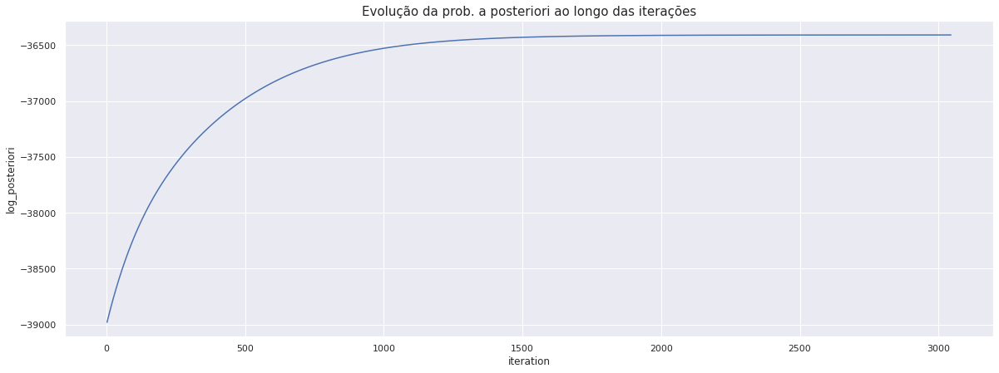

In [121]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

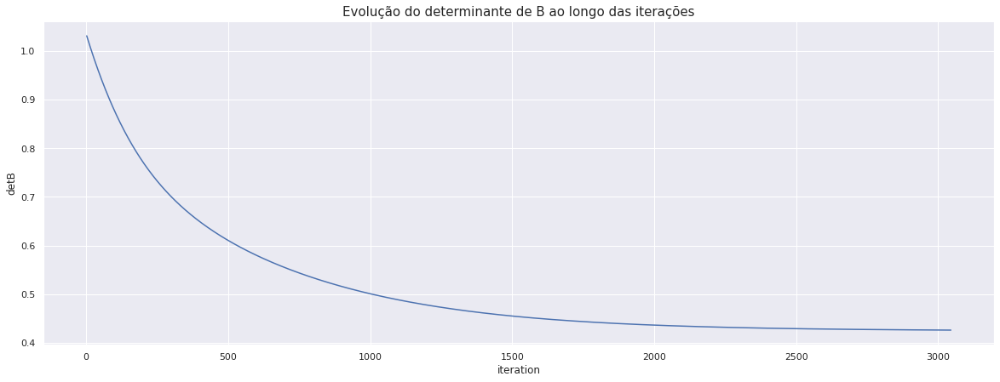

In [122]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

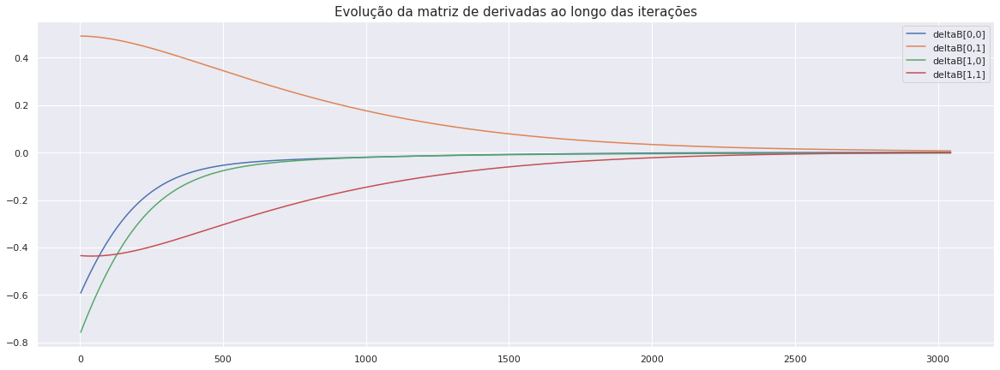

In [123]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [124]:
B

array([[ 0.3052715 , -0.69353207],
       [ 0.33772114,  0.62930106]])

In [125]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

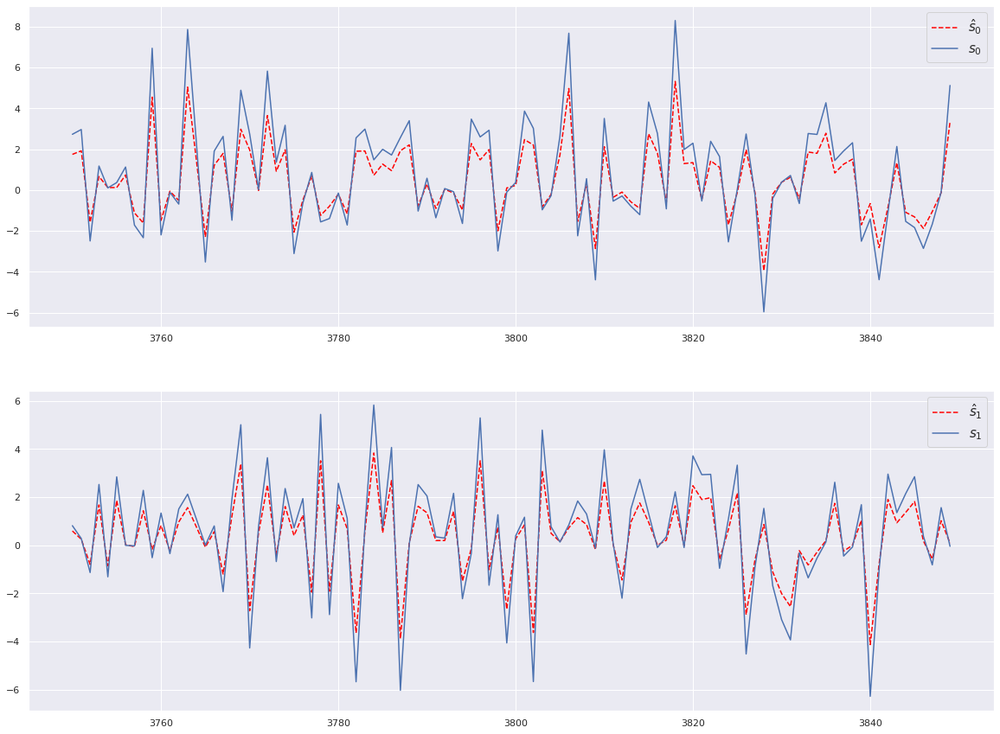

In [126]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [127]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.007931396230619118


### 2.3.2. MAP - determinant equal to one

In [128]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    sig=0.1
    desired_det=1
    return (1/np.sqrt(2*np.pi*np.square(sig)))*np.exp(-np.square(np.linalg.det(B)-desired_det)/(2*np.square(sig)))

In [129]:
%%time

u_lims = (-1, 1)
v_lims = (-1, 1)
n_points = 200

u_vec = np.linspace(u_lims[0], u_lims[-1], n_points)
v_vec = np.linspace(v_lims[0], v_lims[-1], n_points)

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

LinAlgError: Singular matrix

In [130]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=0.1758793969849246, v=-0.48743718592964824
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

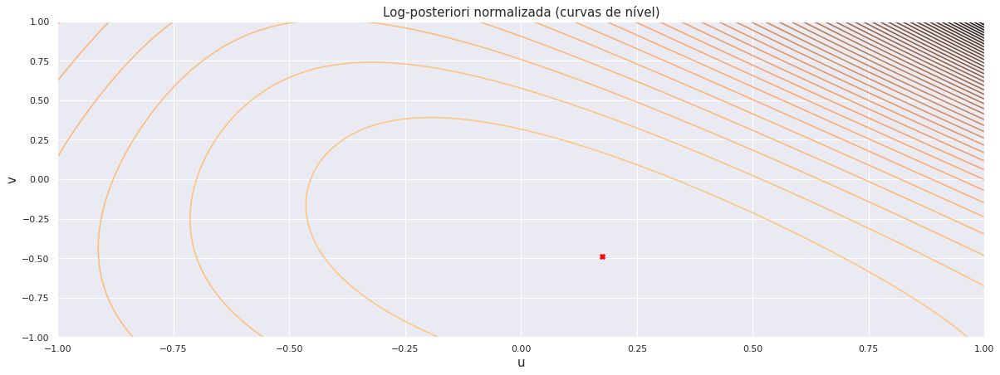

In [131]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



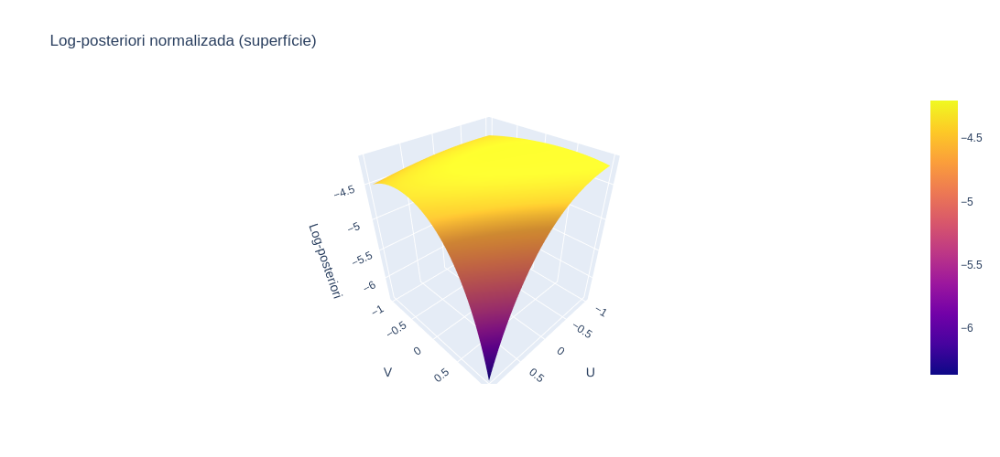

In [132]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [133]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])

def prior_pdf(X):
    sig=0.1
    desired_det=1
    return (1/np.sqrt(2*np.pi*np.square(sig)))*np.exp(-np.square(np.linalg.det(X)-desired_det)/(2*np.square(sig)))

def prior_pdf_derivative(X):
    sig=0.1
    return -1*prior_pdf(X)*(np.linalg.det(X)-1)/np.square(sig)

## 3.1. Standard Gradient

In [134]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [135]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 2898
Final log-posteriori: -36423.03636011298
----------------------------------------------------------------------------------------------------
CPU times: user 14min 24s, sys: 2min 36s, total: 17min
Wall time: 11min 57s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

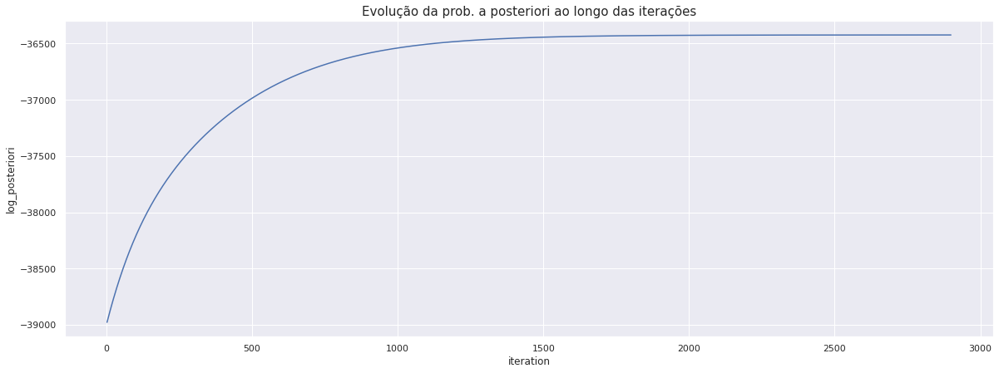

In [136]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

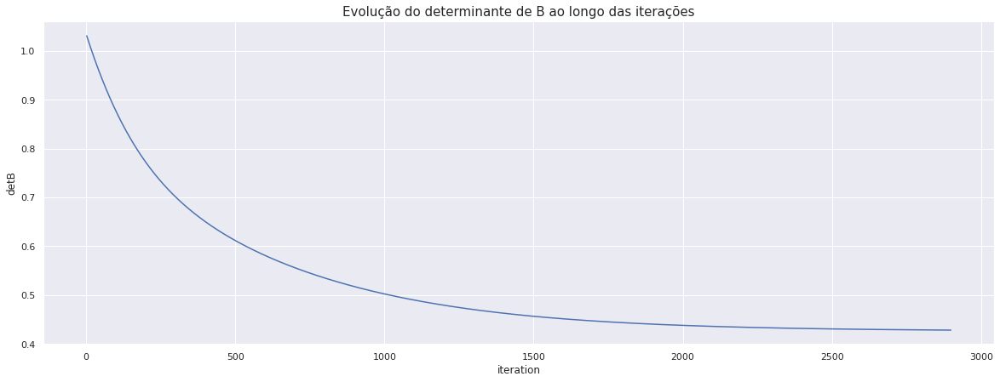

In [137]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

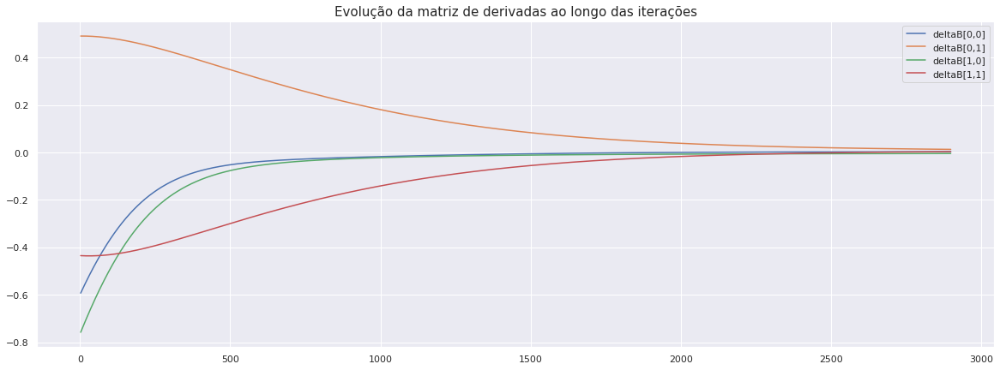

In [138]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [139]:
B

array([[ 0.31114747, -0.68278962],
       [ 0.33431782,  0.64267774]])

In [140]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

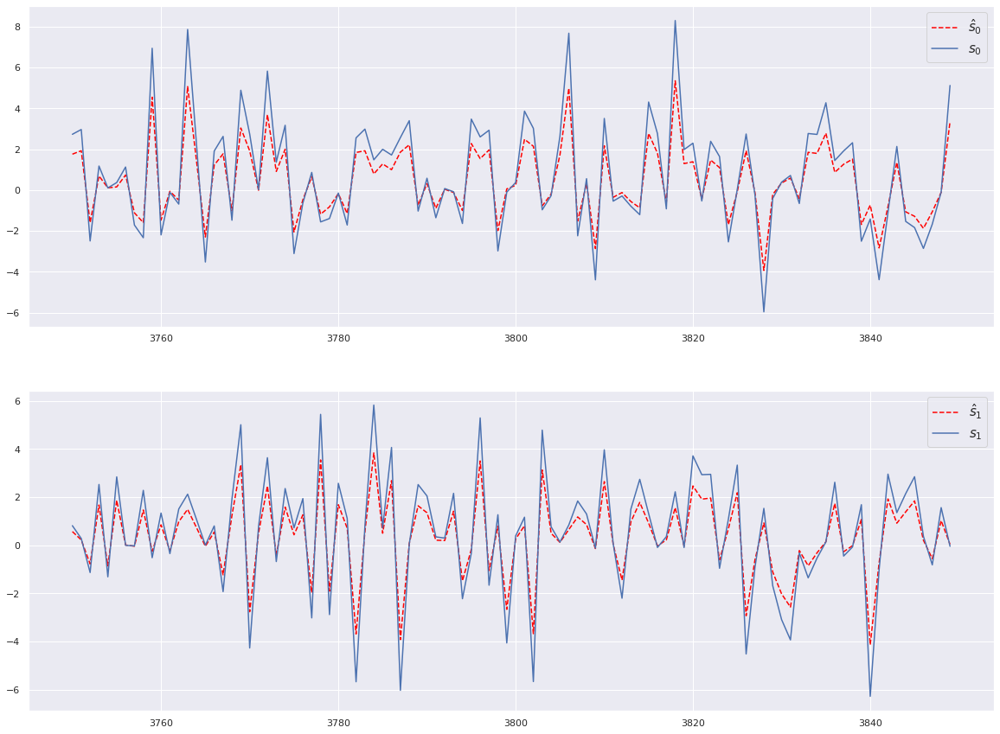

In [141]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [142]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.007869652901626422


## 2.3.3. MAP - near-identity transformation

In [143]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    sig=0.1
    return np.exp(
        (-1/2/np.square(sig))*np.square(np.linalg.norm(B-np.eye(B.shape[0])))
    )

In [144]:
%%time

u_lims = (-1, 1)
v_lims = (-1, 1)
n_points = 200

u_vec = np.linspace(u_lims[0], u_lims[-1], n_points)
v_vec = np.linspace(v_lims[0], v_lims[-1], n_points)

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

LinAlgError: Singular matrix

In [145]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=0.1758793969849246, v=-0.48743718592964824
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

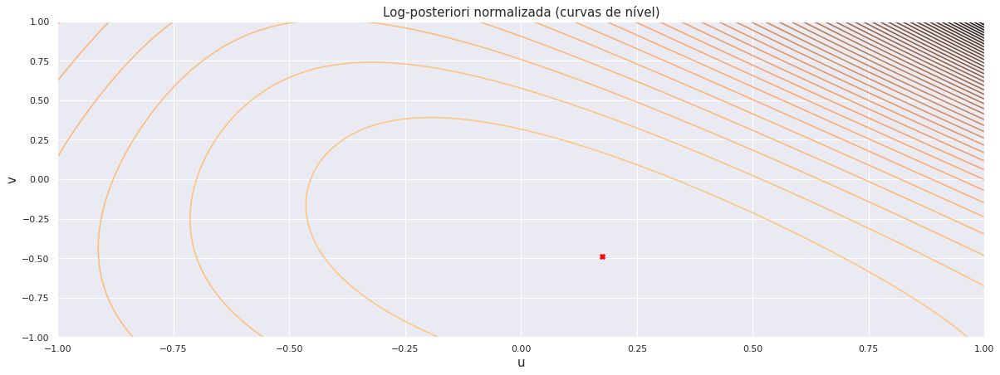

In [146]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



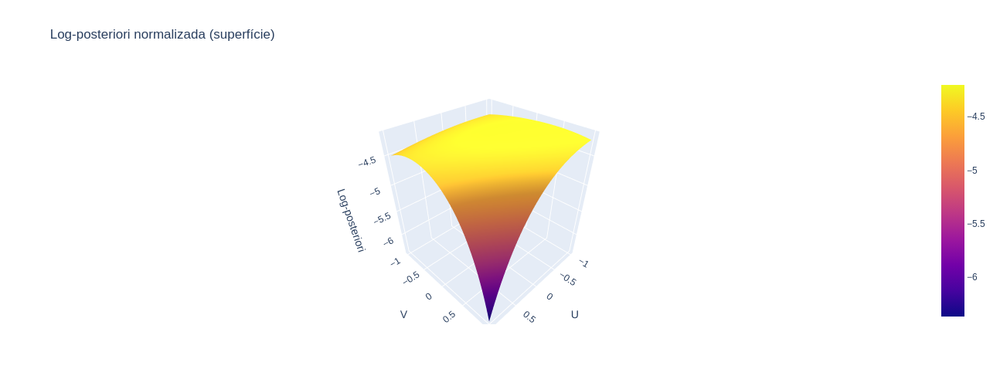

In [147]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [148]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])

def prior_pdf(X):
    sig=0.1
    return np.exp(
        (-1/2/np.square(sig))*np.linalg.norm(X-np.eye(X.shape[0]))
    )

def prior_pdf_derivative(X):
    sig=0.1
    der_X=np.empty(X.shape)
    I=np.eye(X.shape[0])
    for i, j in np.ndindex(X.shape):
        der_X[i, j] = prior_pdf(X)*(-1/np.square(sig))*(X[i,j]-I[i,j])
    return der_X

## 3.1. Standard Gradient

In [149]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [150]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 3854
Final log-posteriori: -36461.013596780285
----------------------------------------------------------------------------------------------------
CPU times: user 19min 1s, sys: 3min 29s, total: 22min 30s
Wall time: 15min 46s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

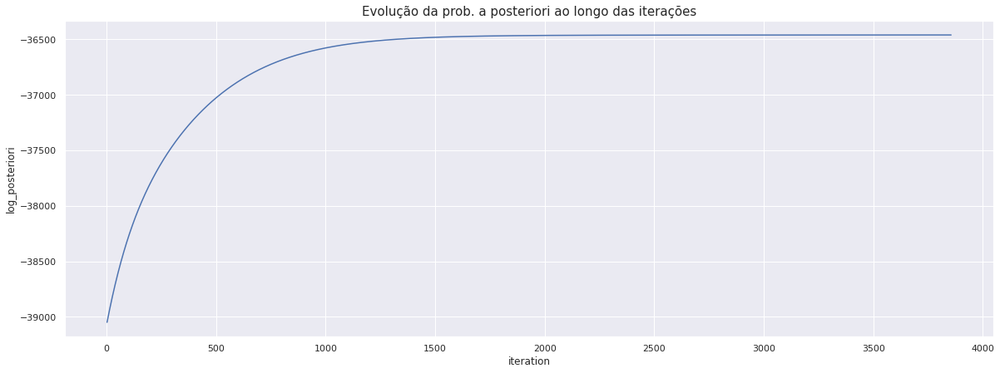

In [151]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

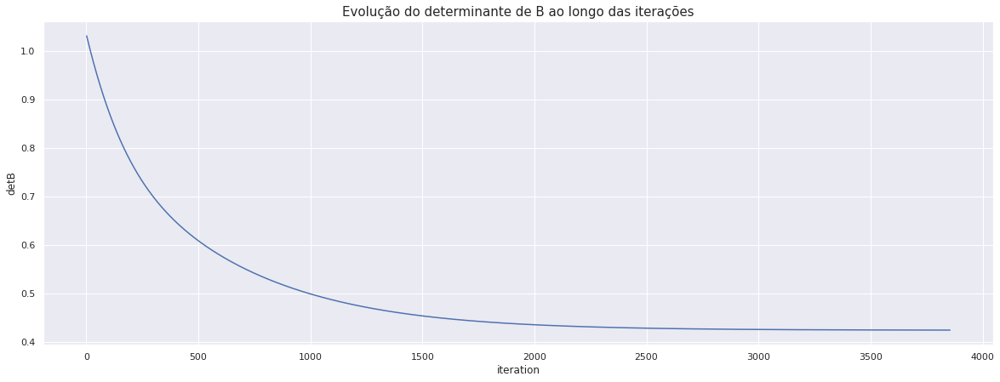

In [152]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

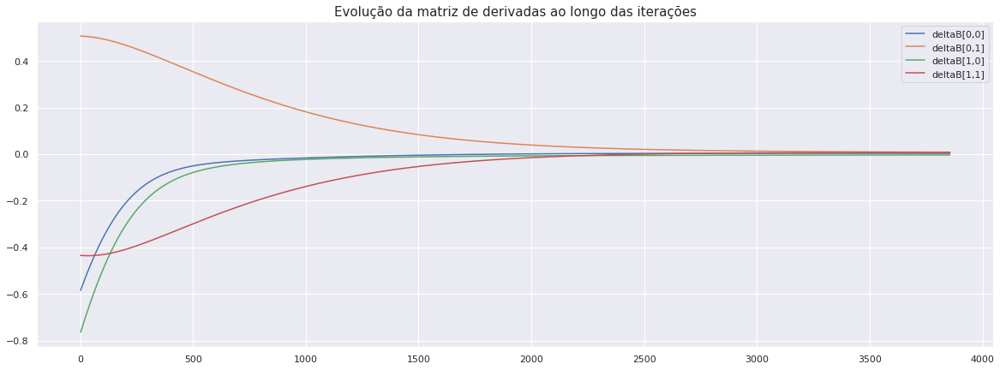

In [153]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [154]:
B

array([[ 0.31773882, -0.66644726],
       [ 0.32609563,  0.65252477]])

In [155]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

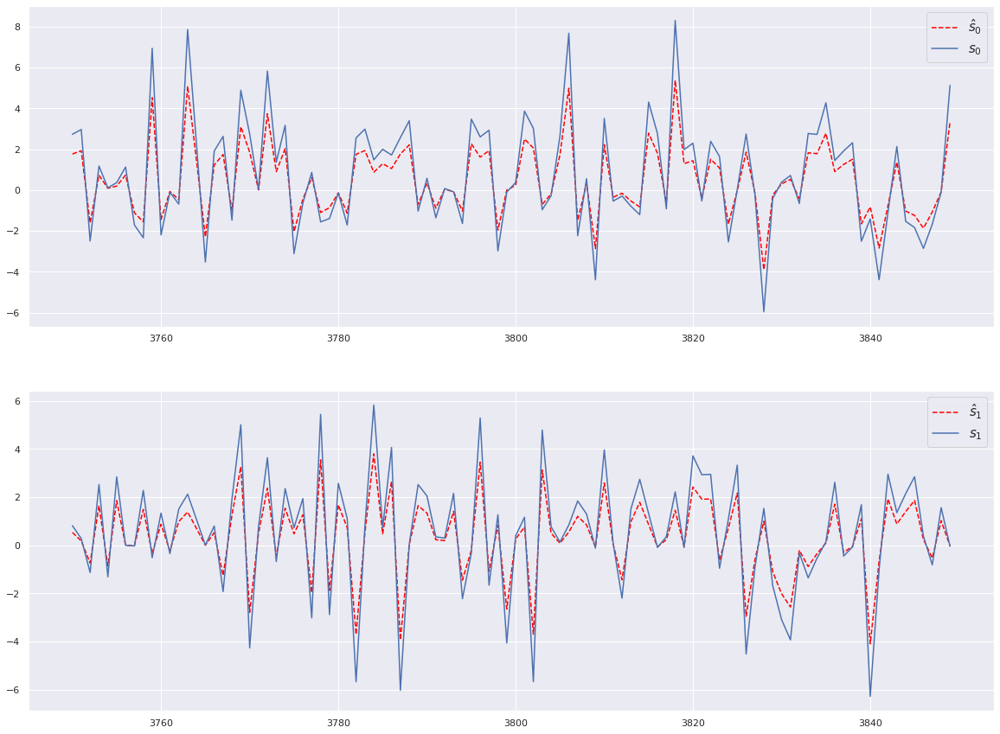

In [156]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [157]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.007910452699809693


# 4. LARGELY MISSPECIFIED MODEL - SUPERGAUSSIAN

## 3.1. Initialize Sources

In [158]:
def source_cumulative(x):
    return 1/(1+np.exp(-x))

def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def source_generator(
    nsources,
    nobs,
    mu,
    scale
):
    return np.random.laplace(
        loc=mu,
        scale=scale,
        size=(nsources, nobs)
    )

In [159]:
NSOURCES=2
NOBS=7500
MU=0
SCALE=1

s = source_generator(
    nsources=NSOURCES,
    nobs=NOBS,
    mu=MU,
    scale=SCALE
)

print('-'*100)
print('NÚMERO DE FONTES: {}'.format(NSOURCES))
print('TAMANHO DOS SINAIS DAS FONTES: {}'.format(NOBS))
for i in range(s.shape[0]):
    print(
        'CURTOSE s{}: {}'.format(
            i,
            st.kurtosis(a=s[i,:])
        )
    )
    
print('-'*100)

----------------------------------------------------------------------------------------------------
NÚMERO DE FONTES: 2
TAMANHO DOS SINAIS DAS FONTES: 7500
CURTOSE s0: 3.229859534811859
CURTOSE s1: 2.483467270108604
----------------------------------------------------------------------------------------------------


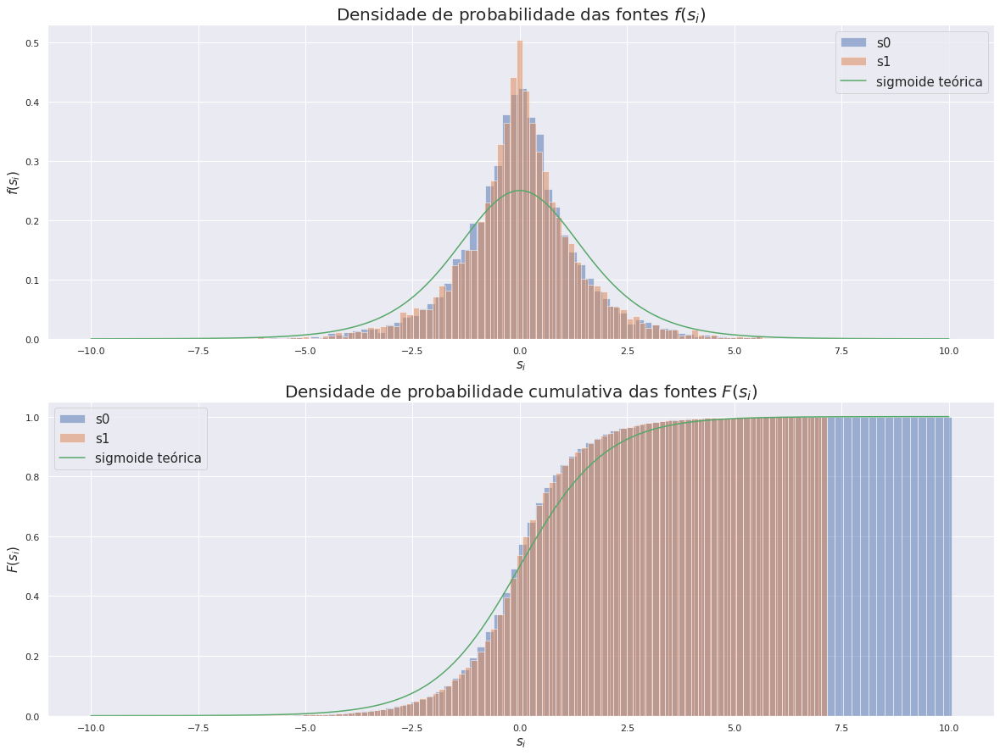

In [160]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)


for i in range(1, NSOURCES+1):
    ax1.hist(
        x=s[i-1,:],
        bins=100,
        density=True,
        label='s{}'.format(i-1),
        alpha=0.5
    )
    ax2.hist(
        x=s[i-1,:],
        bins=100,
        cumulative=True,
        density=True,
        label='s{}'.format(i-1),
        alpha=0.5
    )
    
ax1.plot(
    np.linspace(-10,10,1000),
    [source_pdf(x) for x in np.linspace(-10,10,1000)],
    label='sigmoide teórica'
)


ax2.plot(
    np.linspace(-10,10,1000),
    [source_cumulative(x) for x in np.linspace(-10,10,1000)],
    label='sigmoide teórica'
)

ax1.set_xlabel(
    '$s_{i}$',
    fontsize=15
)
ax1.set_ylabel(
    '$f(s_{i})$',
    fontsize=15
)
ax1.set_title(
    'Densidade de probabilidade das fontes $f(s_{i})$',
    fontsize=20
)

ax2.set_xlabel(
    '$s_{i}$',
    fontsize=15
)
ax2.set_ylabel(
    '$F(s_{i})$',
    fontsize=15
)
ax2.set_title(
    'Densidade de probabilidade cumulativa das fontes $F(s_{i})$',
    fontsize=20
)

l1=ax1.legend(fontsize=15)
l2=ax2.legend(fontsize=15)

## 2.2. Mix sources and generate observations

In [161]:
# Mixing matrix
A = np.array([
    [1, 1],
    [-0.5, 0.5]
])
print('MIXING MATRIX A:')
print(A)

MIXING MATRIX A:
[[ 1.   1. ]
 [-0.5  0.5]]


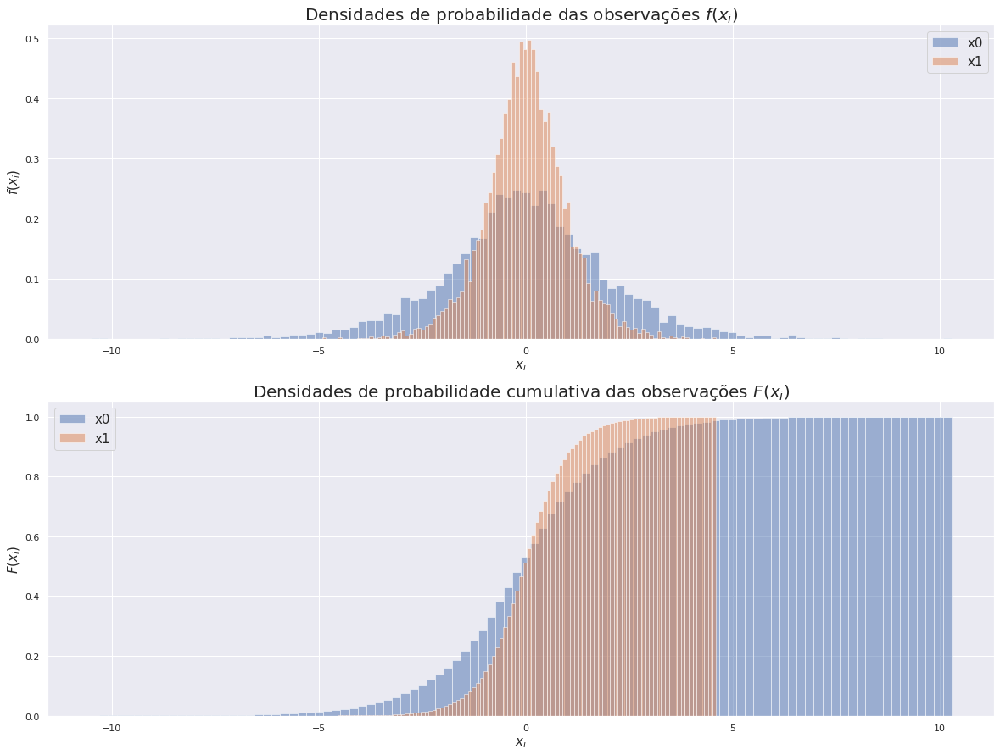

In [162]:
# Observed sources
x = A@s

fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)

for i in range(1, NSOURCES+1):
    ax1.hist(
        x=x[i-1,:],
        bins=100,
        density=True,
        label='x{}'.format(i-1),
        alpha=0.5
    )
    ax2.hist(
        x=x[i-1,:],
        bins=100,
        cumulative=True,
        density=True,
        label='x{}'.format(i-1),
        alpha=0.5
    )

ax1.set_xlabel(
    '$x_{i}$',
    fontsize=15
)
ax1.set_ylabel(
    '$f(x_{i})$',
    fontsize=15
)
ax1.set_title(
    'Densidades de probabilidade das observações $f(x_{i})$',
    fontsize=20
)

ax2.set_xlabel(
    '$x_{i}$',
    fontsize=15
)
ax2.set_ylabel(
    '$F(x_{i})$',
    fontsize=15
)
ax2.set_title(
    'Densidades de probabilidade cumulativa das observações $F(x_{i})$',
    fontsize=20
)

l1=ax1.legend(fontsize=15)
l2=ax2.legend(fontsize=15)

## 2.3. Performance Curves

In [163]:
def get_posteriori_neighborhood(
    A,
    x,
    T,
    u_vec,
    v_vec,
    n_points,
    source_pdf_fn,
    prior_pdf_fn,
    njobs=1
):
    
    def __get_posteriori(
        A,
        x,
        T,
        source_pdf_fn,
        prior_pdf_fn,
        idx_info
    ):
        i, u = idx_info[0]
        j, v = idx_info[-1]
        
        A_shifted = A + u*symmetric_basis + v*skew_symmetric_basis
        
        B = np.linalg.inv(A_shifted)
        
        likelihood = np.log(np.abs(np.linalg.det(B)))
        
        likelihood_iterator = [
            (t,i) for t,i in itertools.product(
                range(x.shape[-1]),
                range(x.shape[0]))
        ]

        s_est = B@x

        likelihood += (1/T)*np.sum([
            np.log(source_pdf_fn(s_est[i,t])) for t,i in likelihood_iterator
        ])
        
        prior = np.log(prior_pdf_fn(B))/T
        
        return {
            'i': i,
            'j': j,
            'log_posteriori': likelihood + prior
        }
        

    symmetric_basis = np.array([
        [0, 1],
        [1, 0]
    ])

    skew_symmetric_basis = np.array([
        [0, -1],
        [1, 0]
    ])
    
    iterator = itertools.product(
        enumerate(u_vec),
        enumerate(v_vec)
    )
    # it = [x for x in iterator]
    
    exec_fn = partial(
        __get_posteriori,
        A,
        x,
        T,
        source_pdf_fn,
        prior_pdf_fn
    )
    
    z = np.empty(
        shape=(
            u_vec.shape[0],
            v_vec.shape[0]
        )
    )
    with pathos.multiprocessing.ProcessingPool(njobs) as p:
        results = p.map(exec_fn, iterator)
    
    for r in results:
        i=r['i']
        j=r['j']
        z[i, j]=r['log_posteriori']
    
    return z

### 2.3.1. Likelihood

In [164]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    return 1

In [165]:
%%time

u_lims = (-1, 1)
v_lims = (-1, 1)
n_points = 200

u_vec = np.linspace(u_lims[0], u_lims[-1], n_points)
v_vec = np.linspace(v_lims[0], v_lims[-1], n_points)

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

LinAlgError: Singular matrix

In [166]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=0.1758793969849246, v=-0.48743718592964824
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

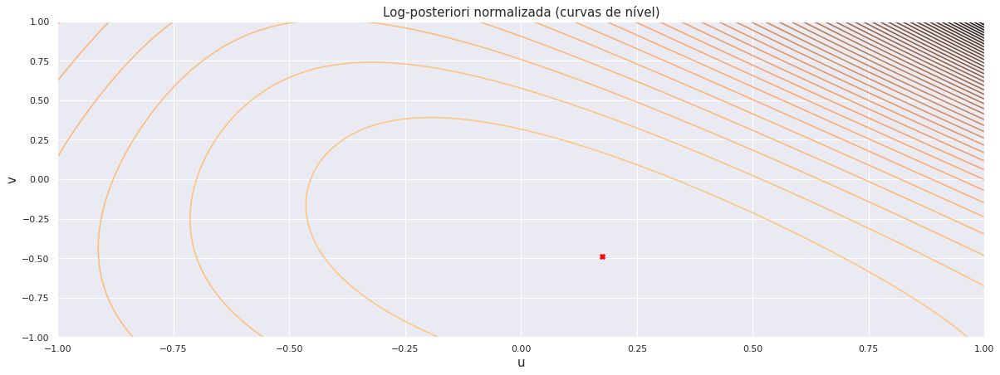

In [167]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



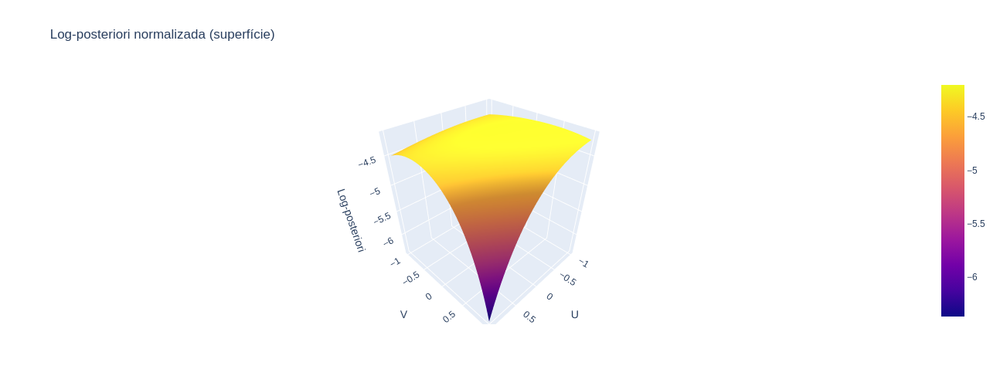

In [168]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [169]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])


def prior_pdf(X):
    """
        This method takes VECTOR value X and return SCALAR prior pdf evaluated at X.
    """
    return 1

def prior_pdf_derivative(X):
    """
        This method takes VECTOR value x and return VECTOR prior pdf derivative evaluated at X.
    """
    return np.zeros(
        shape=X.shape
    )

## 3.1. Standard Gradient

In [170]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [171]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 7719
Final log-posteriori: -25663.923247346498
----------------------------------------------------------------------------------------------------
CPU times: user 39min 14s, sys: 6min 58s, total: 46min 12s
Wall time: 32min 47s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

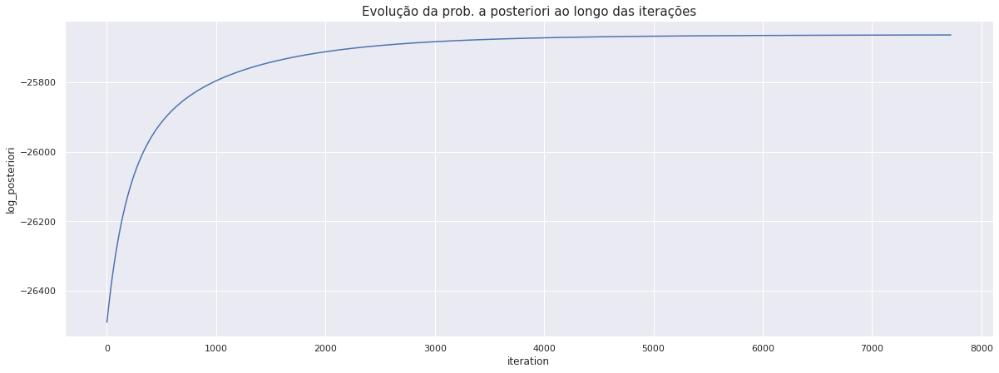

In [172]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

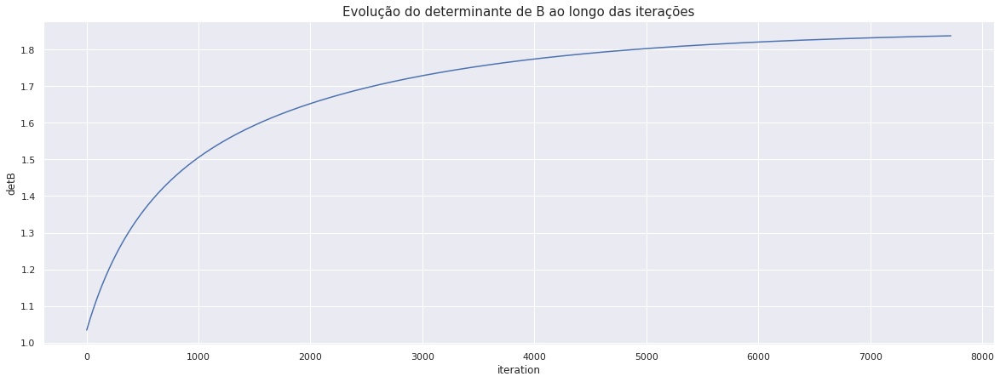

In [173]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

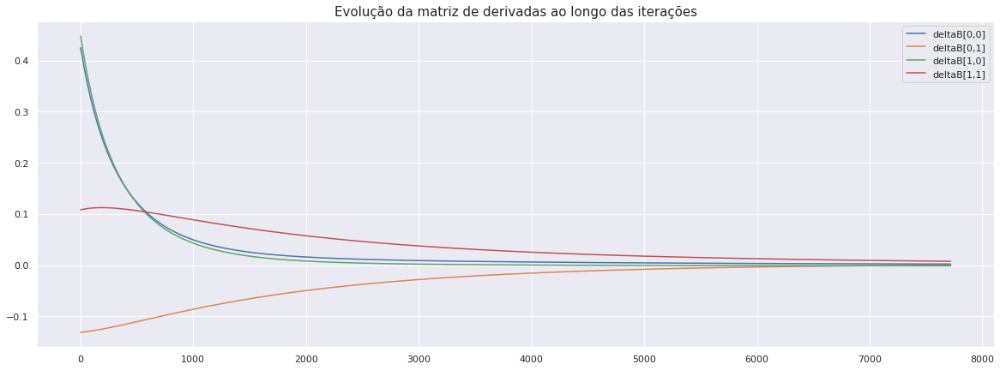

In [174]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [175]:
B

array([[ 0.6551155 , -1.39683907],
       [ 0.6990903 ,  1.31486254]])

In [176]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

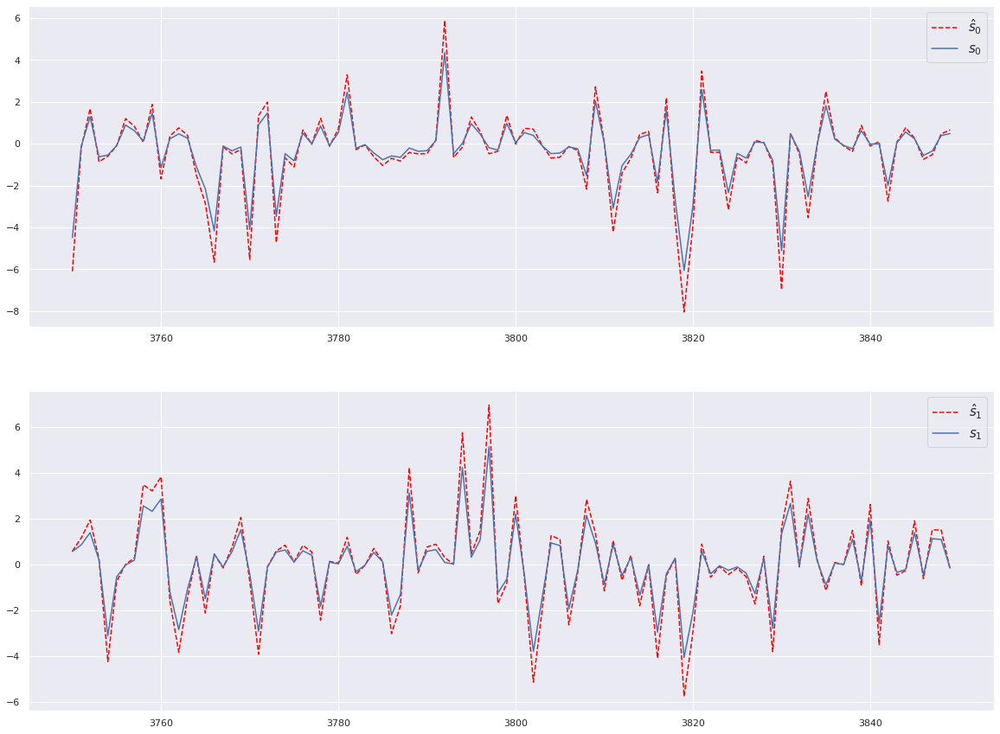

In [177]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [178]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.0040996567821268756


### 2.3.2. MAP - determinant equal to one

In [179]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    sig=0.1
    desired_det=1
    return (1/np.sqrt(2*np.pi*np.square(sig)))*np.exp(-np.square(np.linalg.det(B)-desired_det)/(2*np.square(sig)))

In [180]:
%%time

u_lims = (-1, 1)
v_lims = (-1, 1)
n_points = 200

u_vec = np.linspace(u_lims[0], u_lims[-1], n_points)
v_vec = np.linspace(v_lims[0], v_lims[-1], n_points)

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

LinAlgError: Singular matrix

In [181]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=0.1758793969849246, v=-0.48743718592964824
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

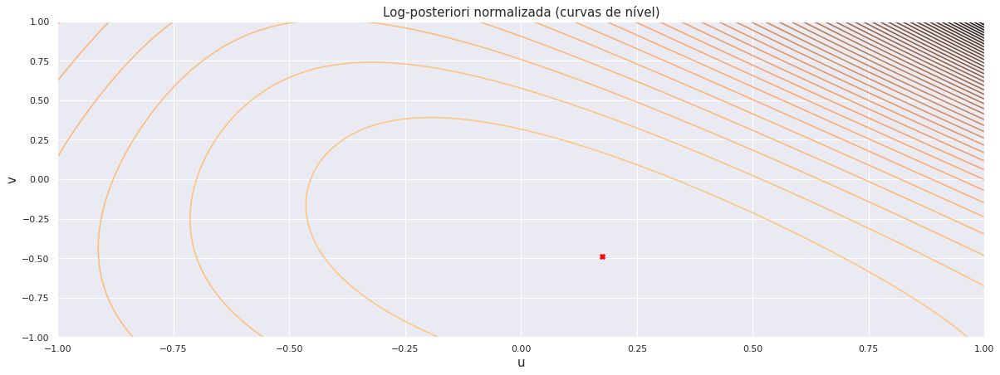

In [182]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



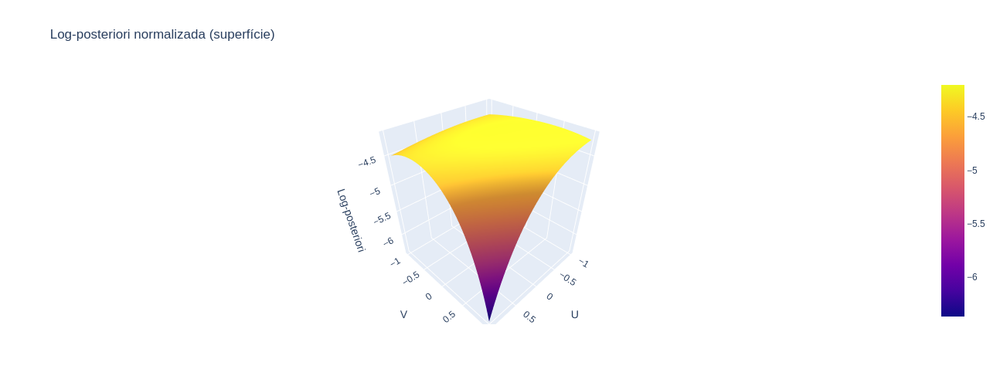

In [183]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [184]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])

def prior_pdf(X):
    sig=0.1
    desired_det=1
    return (1/np.sqrt(2*np.pi*np.square(sig)))*np.exp(-np.square(np.linalg.det(X)-desired_det)/(2*np.square(sig)))

def prior_pdf_derivative(X):
    sig=0.1
    return -1*prior_pdf(X)*(np.linalg.det(X)-1)/np.square(sig)

## 3.1. Standard Gradient

In [185]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [186]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 5165
Final log-posteriori: -25701.550320287548
----------------------------------------------------------------------------------------------------
CPU times: user 26min 12s, sys: 4min 38s, total: 30min 51s
Wall time: 21min 53s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

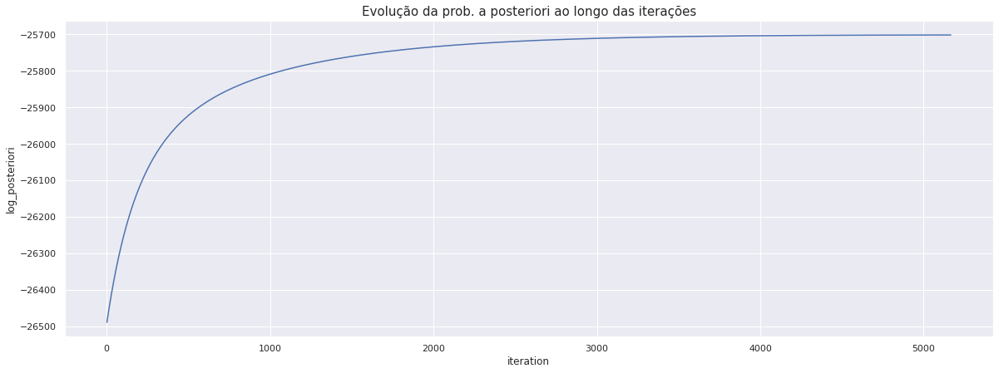

In [187]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

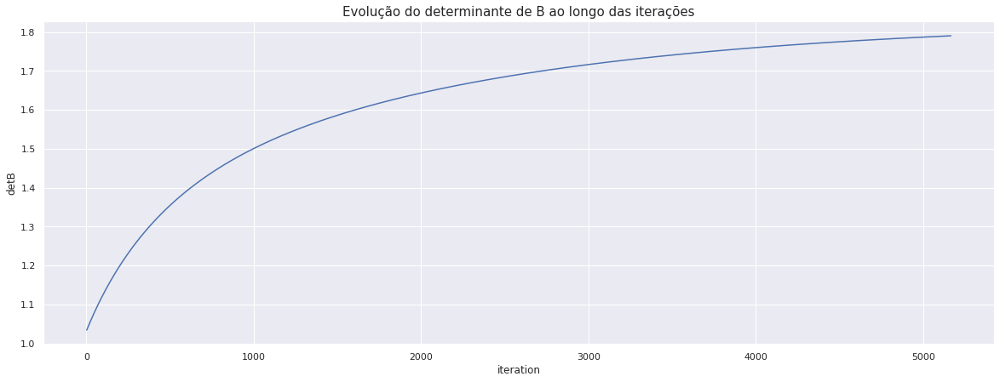

In [188]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

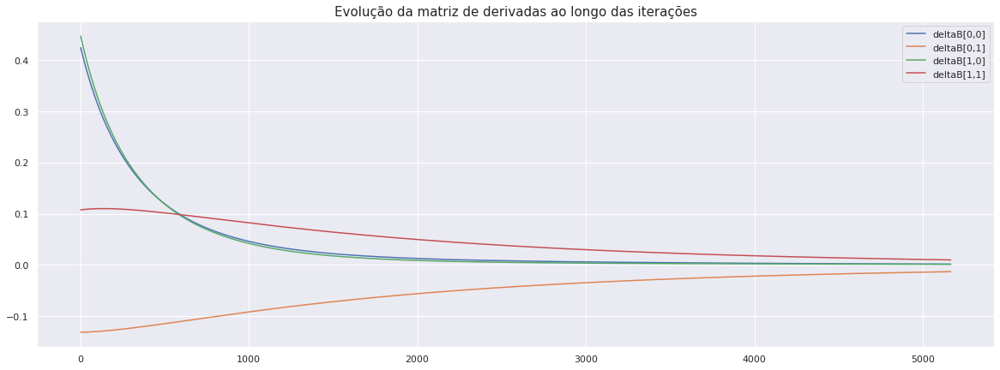

In [189]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [190]:
B

array([[ 0.63135681, -1.42064294],
       [ 0.70453392,  1.2500693 ]])

In [191]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

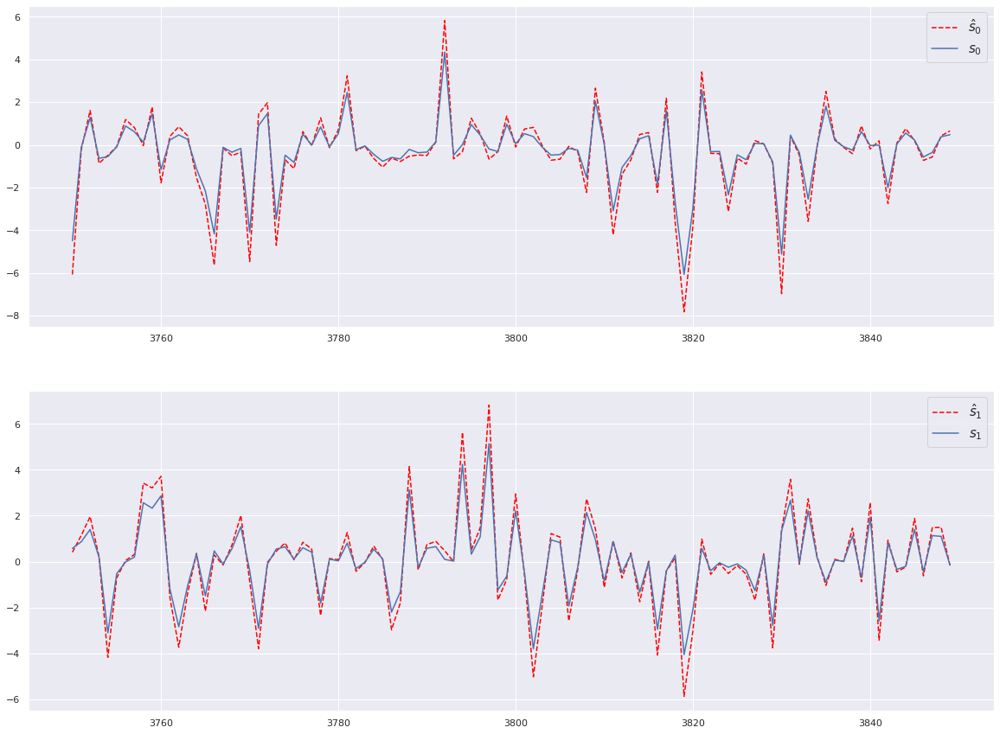

In [192]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [193]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.0039555145624831116


## 2.3.3. MAP - near-identity transformation

In [194]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    sig=0.1
    return np.exp(
        (-1/2/np.square(sig))*np.square(np.linalg.norm(B-np.eye(B.shape[0])))
    )

In [195]:
%%time

u_lims = (-1, 1)
v_lims = (-1, 1)
n_points = 200

u_vec = np.linspace(u_lims[0], u_lims[-1], n_points)
v_vec = np.linspace(v_lims[0], v_lims[-1], n_points)

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

LinAlgError: Singular matrix

In [196]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=0.1758793969849246, v=-0.48743718592964824
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

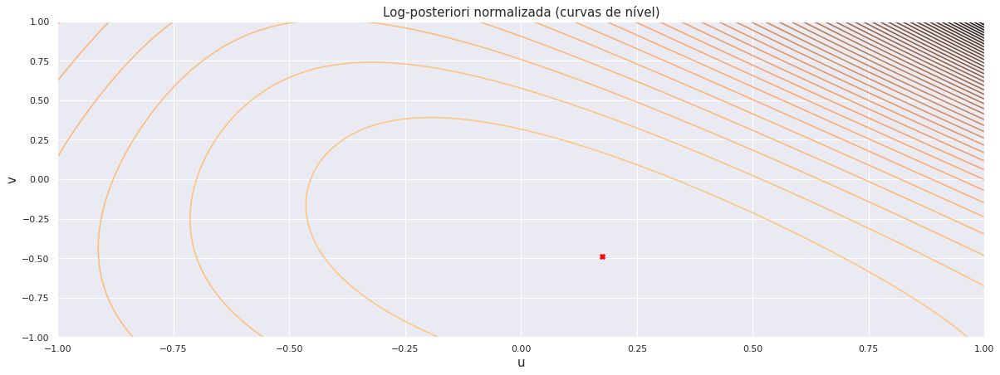

In [197]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



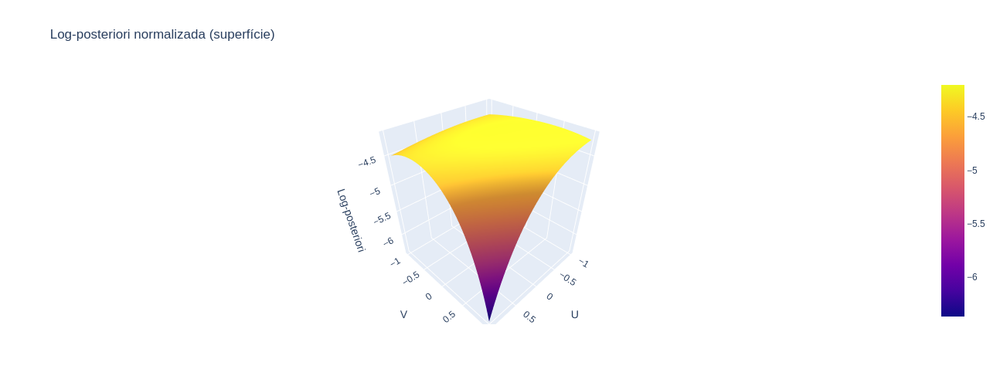

In [198]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [199]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])

def prior_pdf(X):
    sig=0.1
    return np.exp(
        (-1/2/np.square(sig))*np.linalg.norm(X-np.eye(X.shape[0]))
    )

def prior_pdf_derivative(X):
    sig=0.1
    der_X=np.empty(X.shape)
    I=np.eye(X.shape[0])
    for i, j in np.ndindex(X.shape):
        der_X[i, j] = prior_pdf(X)*(-1/np.square(sig))*(X[i,j]-I[i,j])
    return der_X

## 3.1. Standard Gradient

In [200]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [201]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 8302
Final log-posteriori: -25743.59359764015
----------------------------------------------------------------------------------------------------
CPU times: user 43min 1s, sys: 7min 27s, total: 50min 29s
Wall time: 36min 3s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

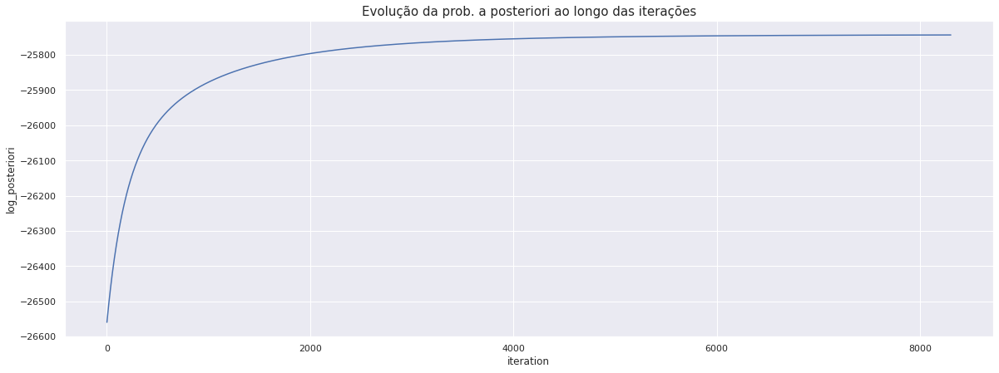

In [202]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

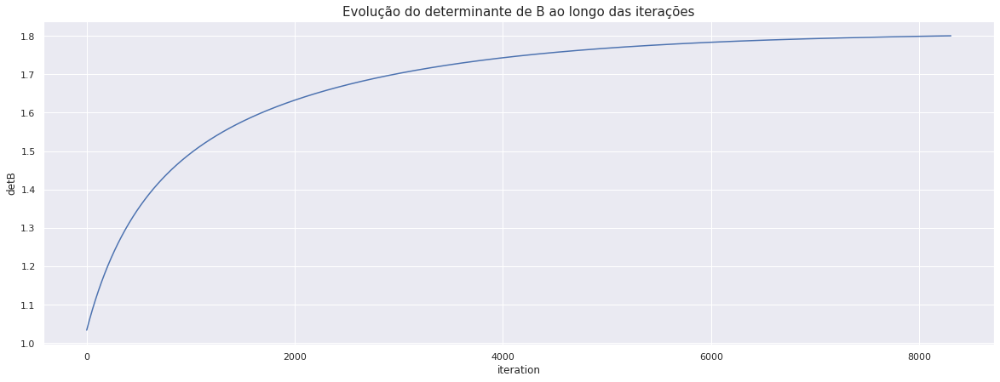

In [203]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

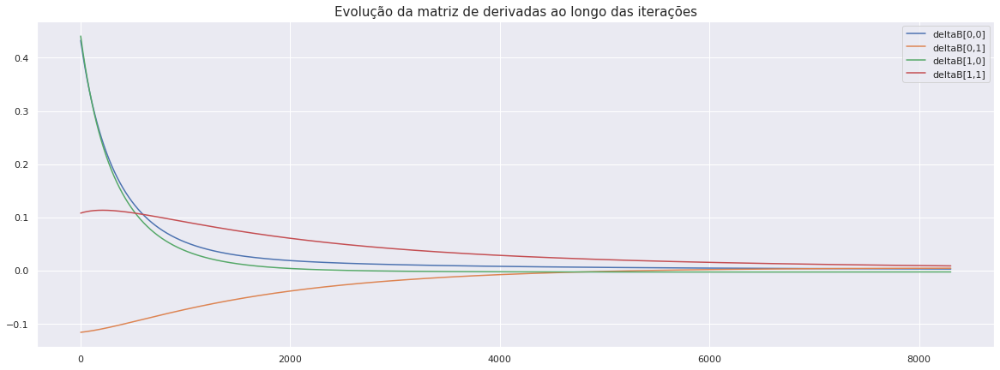

In [204]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [205]:
B

array([[ 0.67536414, -1.32727789],
       [ 0.67302422,  1.34286225]])

In [206]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

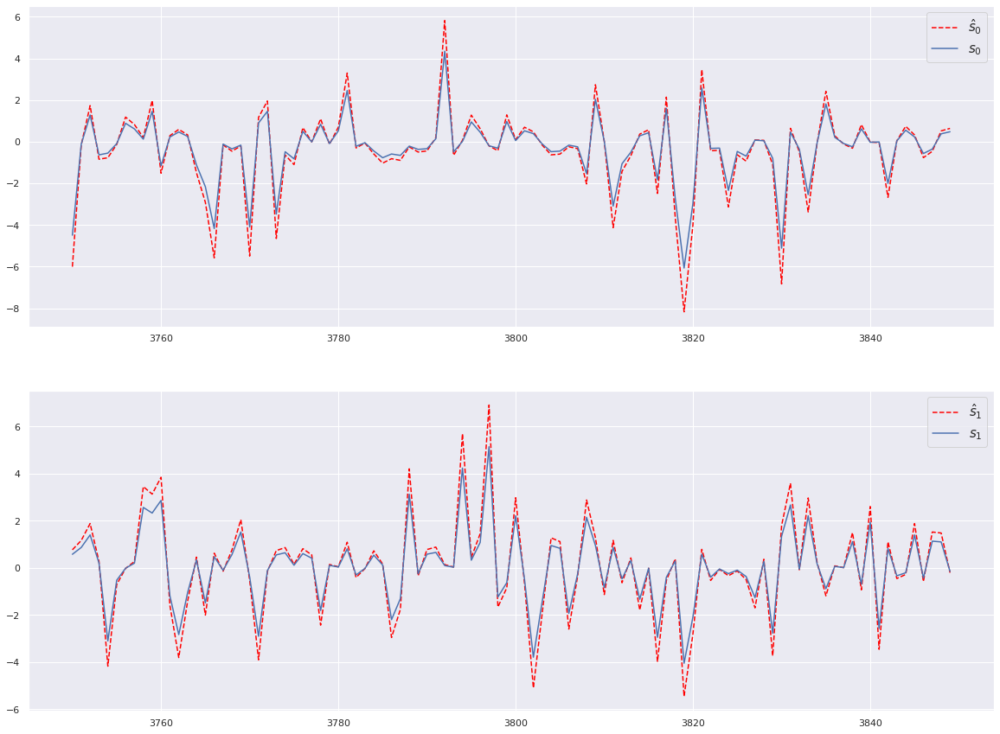

In [207]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [208]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.0039197505631380775


# 4. LARGELY MISSPECIFIED MODEL - SUBGAUSSIAN

## 3.1. Initialize Sources

In [209]:
def source_cumulative(x):
    return 1/(1+np.exp(-x))

def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def source_generator(
    nsources,
    nobs,
    mu,
    scale
):
    return np.random.triangular(
        left=-2,
        mode=0,
        right=2,
        size=(nsources, nobs)
    )

In [210]:
NSOURCES=2
NOBS=7500
MU=0
SCALE=1

s = source_generator(
    nsources=NSOURCES,
    nobs=NOBS,
    mu=MU,
    scale=SCALE
)

print('-'*100)
print('NÚMERO DE FONTES: {}'.format(NSOURCES))
print('TAMANHO DOS SINAIS DAS FONTES: {}'.format(NOBS))
for i in range(s.shape[0]):
    print(
        'CURTOSE s{}: {}'.format(
            i,
            st.kurtosis(a=s[i,:])
        )
    )
    
print('-'*100)

----------------------------------------------------------------------------------------------------
NÚMERO DE FONTES: 2
TAMANHO DOS SINAIS DAS FONTES: 7500
CURTOSE s0: -0.5708517855502775
CURTOSE s1: -0.5944819636332639
----------------------------------------------------------------------------------------------------


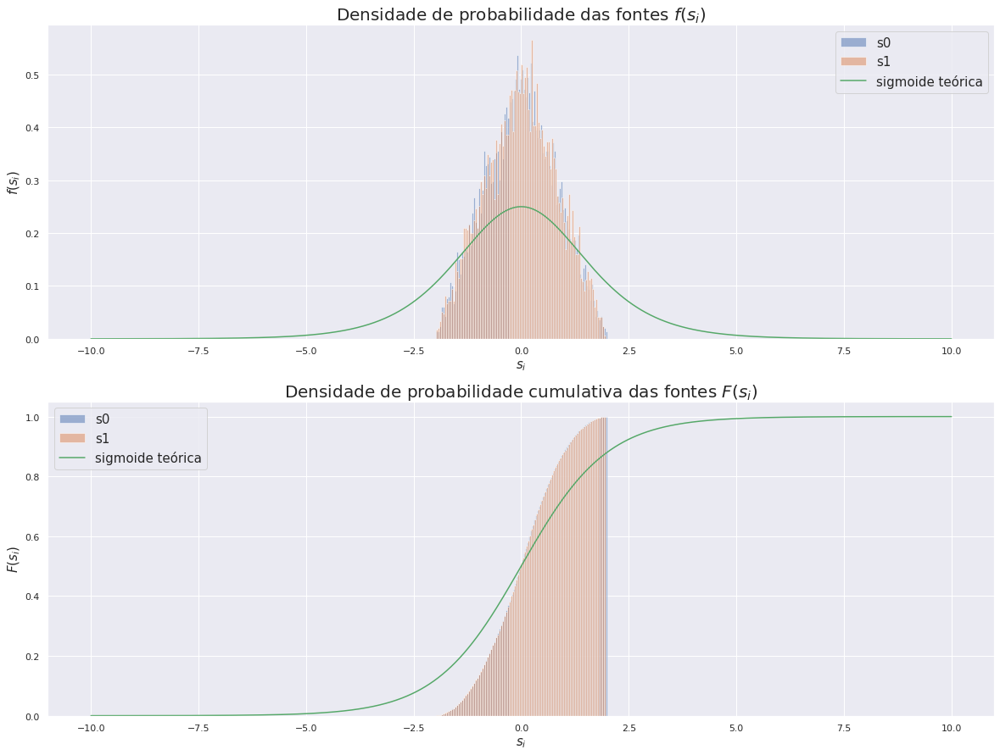

In [211]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)


for i in range(1, NSOURCES+1):
    ax1.hist(
        x=s[i-1,:],
        bins=100,
        density=True,
        label='s{}'.format(i-1),
        alpha=0.5
    )
    ax2.hist(
        x=s[i-1,:],
        bins=100,
        cumulative=True,
        density=True,
        label='s{}'.format(i-1),
        alpha=0.5
    )
    
ax1.plot(
    np.linspace(-10,10,1000),
    [source_pdf(x) for x in np.linspace(-10,10,1000)],
    label='sigmoide teórica'
)


ax2.plot(
    np.linspace(-10,10,1000),
    [source_cumulative(x) for x in np.linspace(-10,10,1000)],
    label='sigmoide teórica'
)

ax1.set_xlabel(
    '$s_{i}$',
    fontsize=15
)
ax1.set_ylabel(
    '$f(s_{i})$',
    fontsize=15
)
ax1.set_title(
    'Densidade de probabilidade das fontes $f(s_{i})$',
    fontsize=20
)

ax2.set_xlabel(
    '$s_{i}$',
    fontsize=15
)
ax2.set_ylabel(
    '$F(s_{i})$',
    fontsize=15
)
ax2.set_title(
    'Densidade de probabilidade cumulativa das fontes $F(s_{i})$',
    fontsize=20
)

l1=ax1.legend(fontsize=15)
l2=ax2.legend(fontsize=15)

## 2.2. Mix sources and generate observations

In [212]:
# Mixing matrix
A = np.array([
    [1, 1],
    [-0.5, 0.5]
])
print('MIXING MATRIX A:')
print(A)

MIXING MATRIX A:
[[ 1.   1. ]
 [-0.5  0.5]]


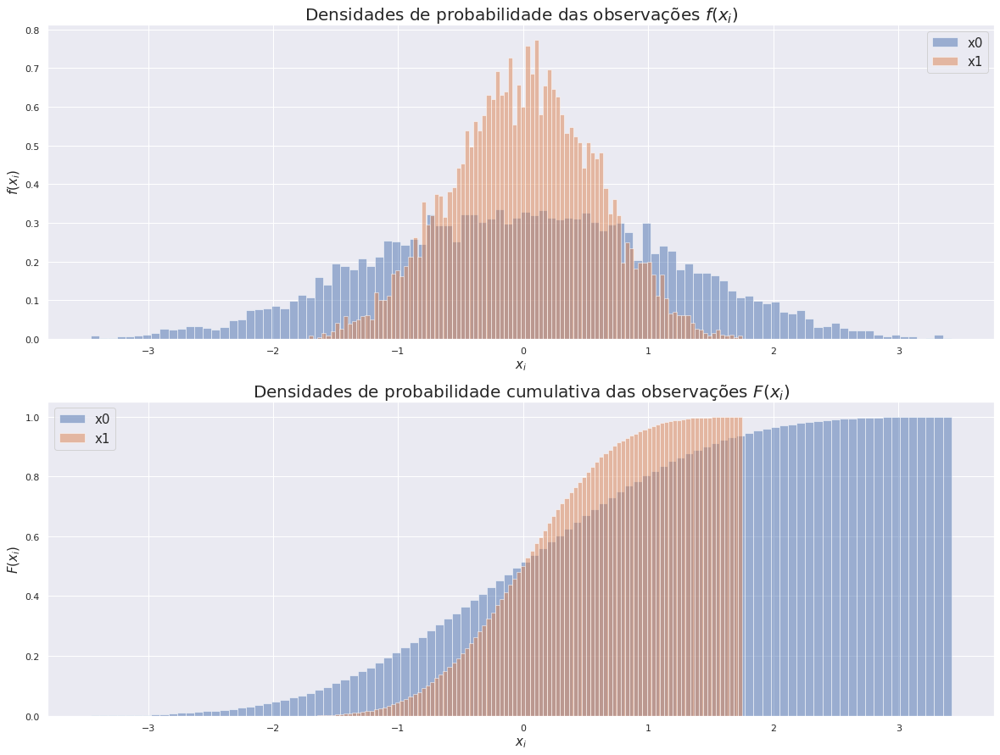

In [213]:
# Observed sources
x = A@s

fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)

for i in range(1, NSOURCES+1):
    ax1.hist(
        x=x[i-1,:],
        bins=100,
        density=True,
        label='x{}'.format(i-1),
        alpha=0.5
    )
    ax2.hist(
        x=x[i-1,:],
        bins=100,
        cumulative=True,
        density=True,
        label='x{}'.format(i-1),
        alpha=0.5
    )

ax1.set_xlabel(
    '$x_{i}$',
    fontsize=15
)
ax1.set_ylabel(
    '$f(x_{i})$',
    fontsize=15
)
ax1.set_title(
    'Densidades de probabilidade das observações $f(x_{i})$',
    fontsize=20
)

ax2.set_xlabel(
    '$x_{i}$',
    fontsize=15
)
ax2.set_ylabel(
    '$F(x_{i})$',
    fontsize=15
)
ax2.set_title(
    'Densidades de probabilidade cumulativa das observações $F(x_{i})$',
    fontsize=20
)

l1=ax1.legend(fontsize=15)
l2=ax2.legend(fontsize=15)

## 2.3. Performance Curves

In [214]:
def get_posteriori_neighborhood(
    A,
    x,
    T,
    u_vec,
    v_vec,
    n_points,
    source_pdf_fn,
    prior_pdf_fn,
    njobs=1
):
    
    def __get_posteriori(
        A,
        x,
        T,
        source_pdf_fn,
        prior_pdf_fn,
        idx_info
    ):
        i, u = idx_info[0]
        j, v = idx_info[-1]
        
        A_shifted = A + u*symmetric_basis + v*skew_symmetric_basis
        
        B = np.linalg.inv(A_shifted)
        
        likelihood = np.log(np.abs(np.linalg.det(B)))
        
        likelihood_iterator = [
            (t,i) for t,i in itertools.product(
                range(x.shape[-1]),
                range(x.shape[0]))
        ]

        s_est = B@x

        likelihood += (1/T)*np.sum([
            np.log(source_pdf_fn(s_est[i,t])) for t,i in likelihood_iterator
        ])
        
        prior = np.log(prior_pdf_fn(B))/T
        
        return {
            'i': i,
            'j': j,
            'log_posteriori': likelihood + prior
        }
        

    symmetric_basis = np.array([
        [0, 1],
        [1, 0]
    ])

    skew_symmetric_basis = np.array([
        [0, -1],
        [1, 0]
    ])
    
    iterator = itertools.product(
        enumerate(u_vec),
        enumerate(v_vec)
    )
    # it = [x for x in iterator]
    
    exec_fn = partial(
        __get_posteriori,
        A,
        x,
        T,
        source_pdf_fn,
        prior_pdf_fn
    )
    
    z = np.empty(
        shape=(
            u_vec.shape[0],
            v_vec.shape[0]
        )
    )
    with pathos.multiprocessing.ProcessingPool(njobs) as p:
        results = p.map(exec_fn, iterator)
    
    for r in results:
        i=r['i']
        j=r['j']
        z[i, j]=r['log_posteriori']
    
    return z

### 2.3.1. Likelihood

In [215]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    return 1

In [216]:
%%time

u_lims = (-1, 1)
v_lims = (-1, 1)
n_points = 200

u_vec = np.linspace(u_lims[0], u_lims[-1], n_points)
v_vec = np.linspace(v_lims[0], v_lims[-1], n_points)

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

LinAlgError: Singular matrix

In [217]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=0.1758793969849246, v=-0.48743718592964824
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

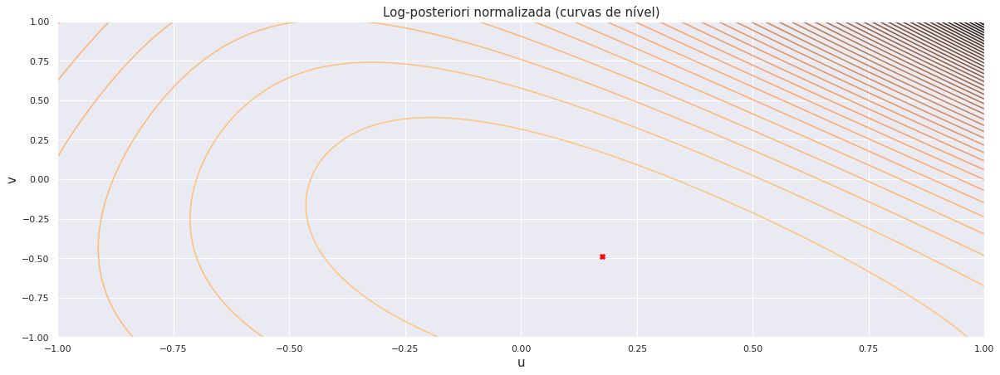

In [218]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



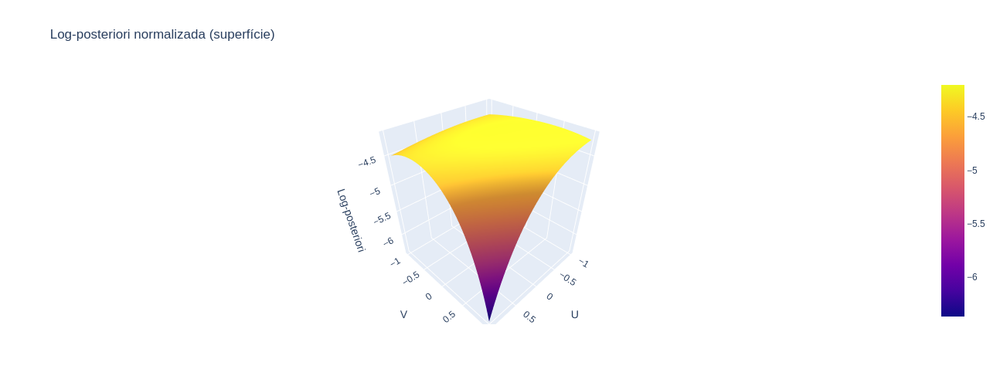

In [219]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [220]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])


def prior_pdf(X):
    """
        This method takes VECTOR value X and return SCALAR prior pdf evaluated at X.
    """
    return 1

def prior_pdf_derivative(X):
    """
        This method takes VECTOR value x and return VECTOR prior pdf derivative evaluated at X.
    """
    return np.zeros(
        shape=X.shape
    )

## 3.1. Standard Gradient

In [221]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [222]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 17358
Final log-posteriori: -18522.17889653367
----------------------------------------------------------------------------------------------------
CPU times: user 1h 28min 46s, sys: 15min 33s, total: 1h 44min 19s
Wall time: 1h 14min 11s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

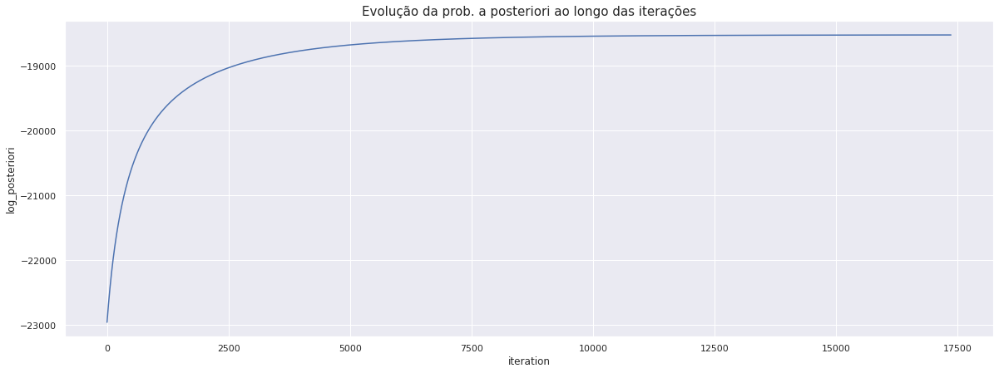

In [223]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

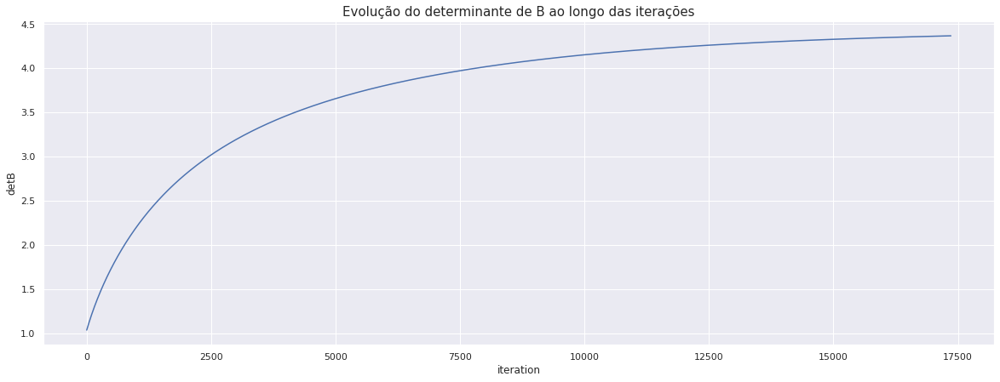

In [224]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

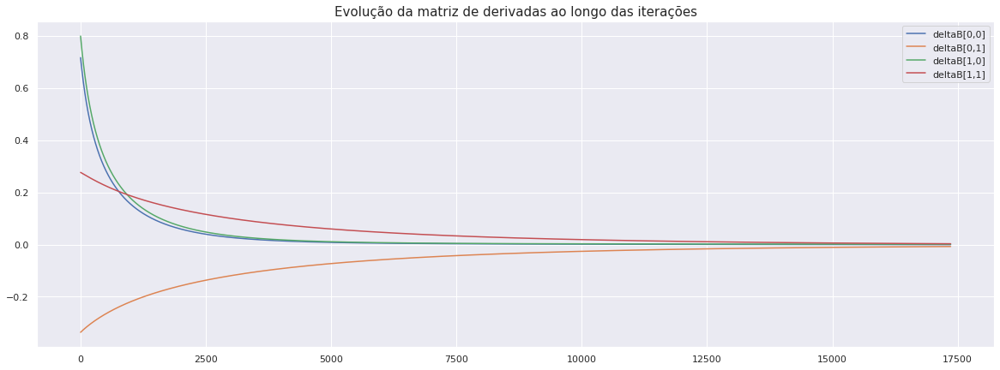

In [225]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [226]:
B

array([[ 0.95583253, -2.25464401],
       [ 1.12785412,  1.90680978]])

In [227]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

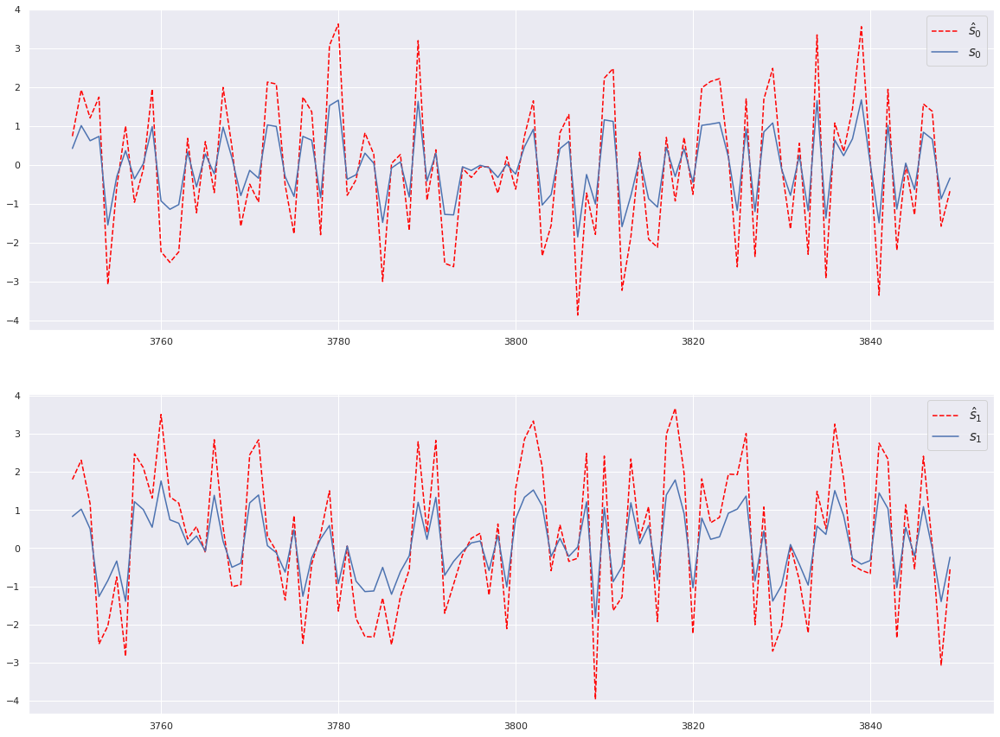

In [228]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [229]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.0072713216386486295


### 2.3.2. MAP - determinant equal to one

In [230]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    sig=0.1
    desired_det=1
    return (1/np.sqrt(2*np.pi*np.square(sig)))*np.exp(-np.square(np.linalg.det(B)-desired_det)/(2*np.square(sig)))

In [231]:
%%time

u_lims = (-1, 1)
v_lims = (-1, 1)
n_points = 200

u_vec = np.linspace(u_lims[0], u_lims[-1], n_points)
v_vec = np.linspace(v_lims[0], v_lims[-1], n_points)

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

LinAlgError: Singular matrix

In [232]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=0.1758793969849246, v=-0.48743718592964824
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

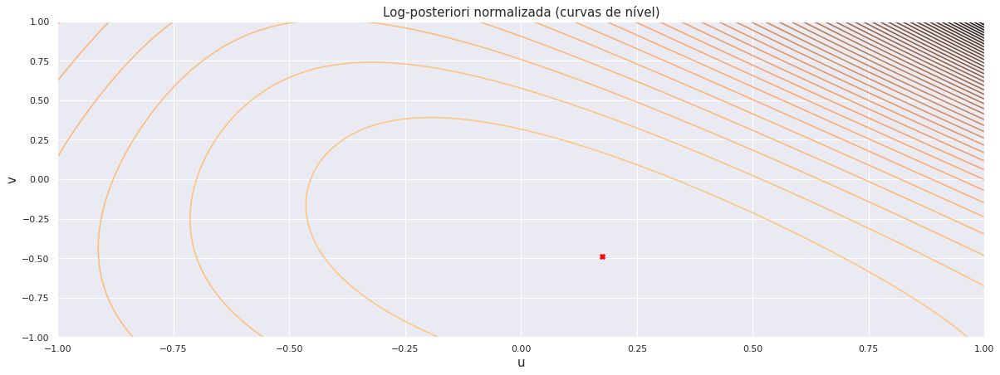

In [233]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



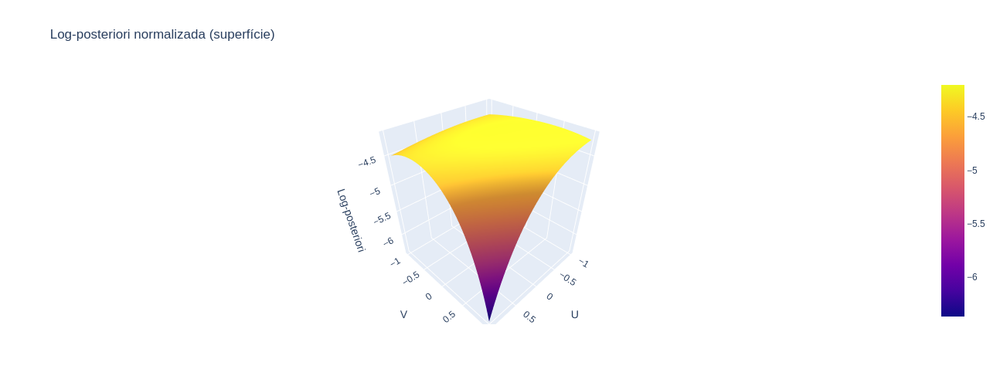

In [234]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [235]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])

def prior_pdf(X):
    sig=0.1
    desired_det=1
    return (1/np.sqrt(2*np.pi*np.square(sig)))*np.exp(-np.square(np.linalg.det(X)-desired_det)/(2*np.square(sig)))

def prior_pdf_derivative(X):
    sig=0.1
    return -1*prior_pdf(X)*(np.linalg.det(X)-1)/np.square(sig)

## 3.1. Standard Gradient

In [236]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [237]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 7215
Final log-posteriori: -18974.77913887492
----------------------------------------------------------------------------------------------------
CPU times: user 35min 47s, sys: 6min 32s, total: 42min 19s
Wall time: 29min 42s


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

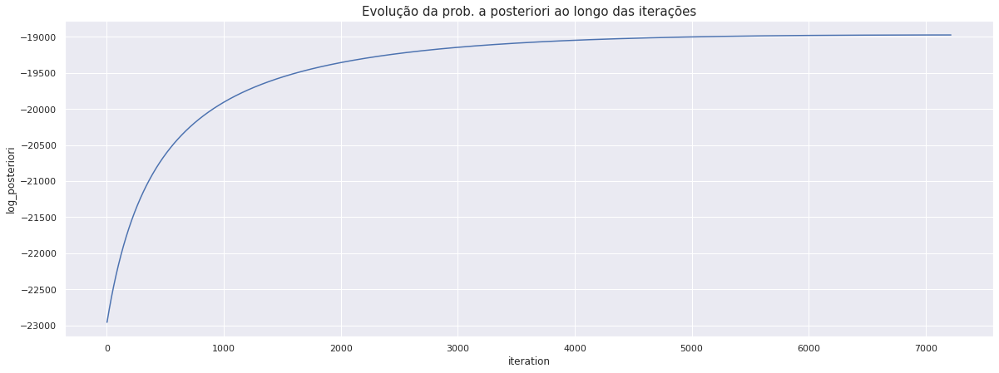

In [238]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

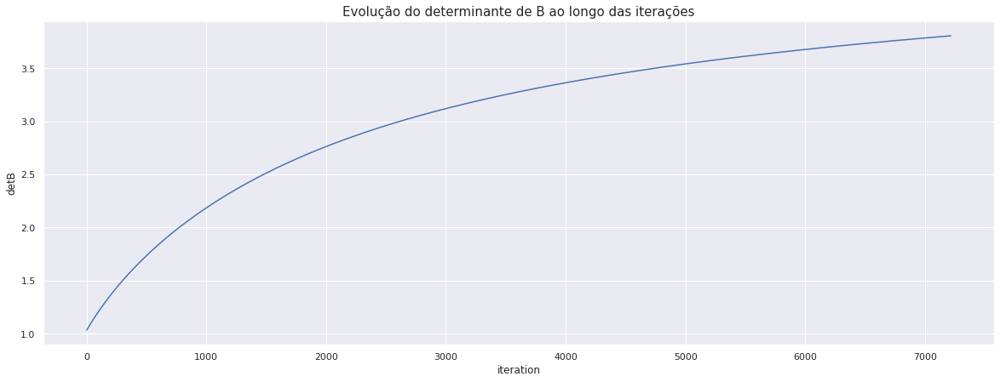

In [239]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

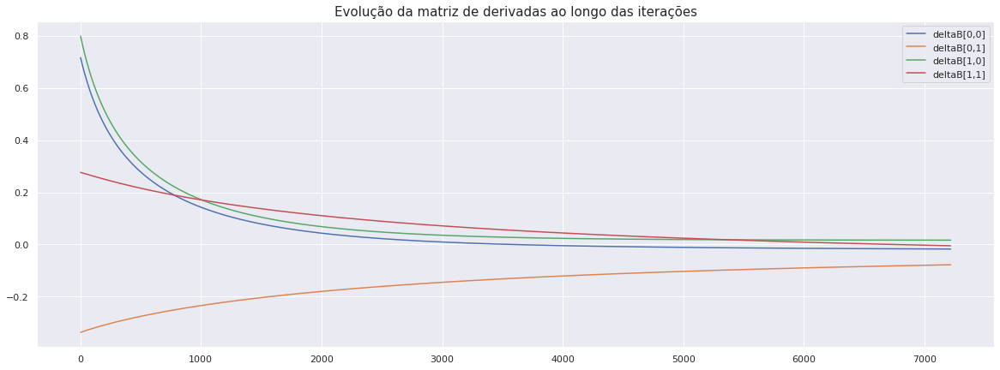

In [240]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [241]:
B

array([[ 0.82494616, -2.23120031],
       [ 1.12810925,  1.56060663]])

In [242]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

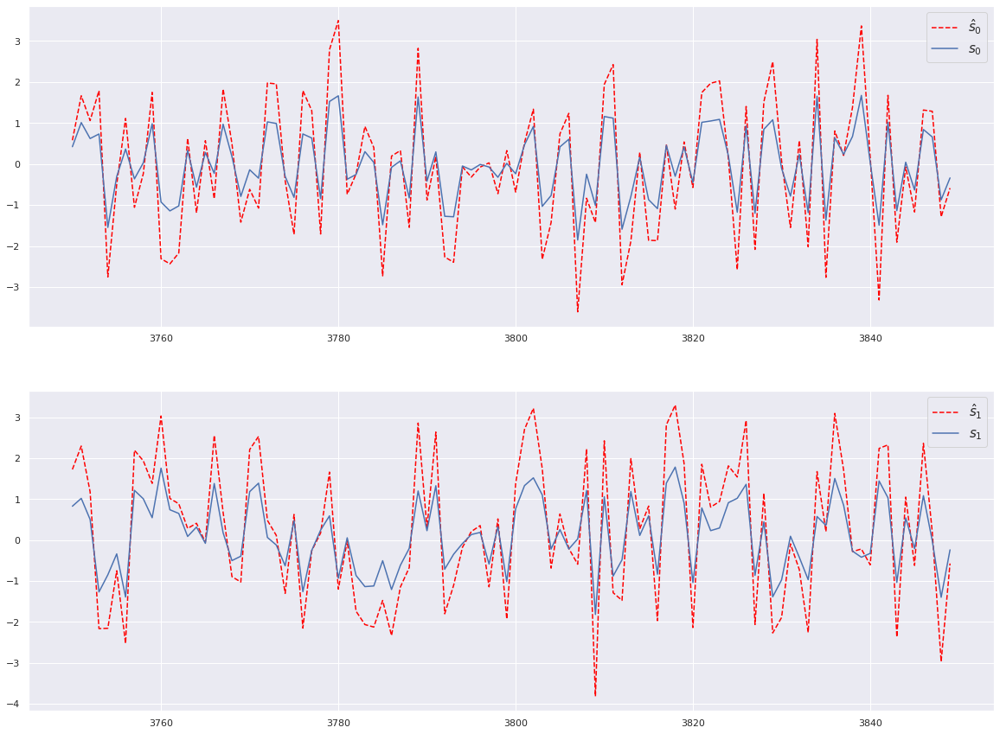

In [243]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [244]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.006493109914702625


## 2.3.3. MAP - near-identity transformation

In [245]:
def source_pdf(x):
    return np.exp(-x)/np.square(1+np.exp(-x))

def prior_pdf(B):
    sig=0.1
    return np.exp(
        (-1/2/np.square(sig))*np.square(np.linalg.norm(B-np.eye(B.shape[0])))
    )

In [246]:
%%time

u_lims = (-1, 1)
v_lims = (-1, 1)
n_points = 200

u_vec = np.linspace(u_lims[0], u_lims[-1], n_points)
v_vec = np.linspace(v_lims[0], v_lims[-1], n_points)

z = get_posteriori_neighborhood(
    A=A,
    x=x,
    T=NOBS,
    u_vec=u_vec,
    v_vec=v_vec,
    n_points=n_points,
    source_pdf_fn=source_pdf,
    prior_pdf_fn=prior_pdf,
    njobs=os.cpu_count()-1
)

LinAlgError: Singular matrix

In [247]:
# Ponto de máximo
max_post_point = np.unravel_index(
    z.argmax(), 
    z.shape
)

#
max_post = z[max_post_point]

print('-'*100)
print('Ponto de máximo: u={}, v={}'.format(u_vec[max_post_point[0]], v_vec[max_post_point[1]]))
print('-'*100)

----------------------------------------------------------------------------------------------------
Ponto de máximo: u=0.1758793969849246, v=-0.48743718592964824
----------------------------------------------------------------------------------------------------


Text(0.5, 1.0, 'Log-posteriori normalizada (curvas de nível)')

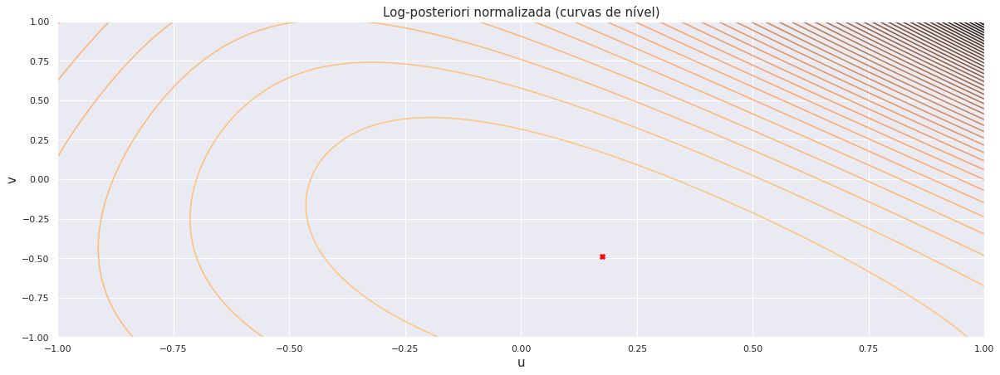

In [248]:
# Plot de curvas de nível
fig = plt.figure(figsize=(20,7))

U, V = np.meshgrid(u_vec, v_vec)

plt.contour(
    U,
    V,
    z.T,
    levels=50,
    cmap='copper'
)

plt.scatter(
    u_vec[max_post_point[0]],
    v_vec[max_post_point[-1]],
    marker='X',
    color='red'
)

plt.xlabel(
    'u',
    fontsize=15
)
plt.ylabel(
    'v',
    fontsize=15
)

plt.title(
    'Log-posteriori normalizada (curvas de nível)',
    fontsize=15
)



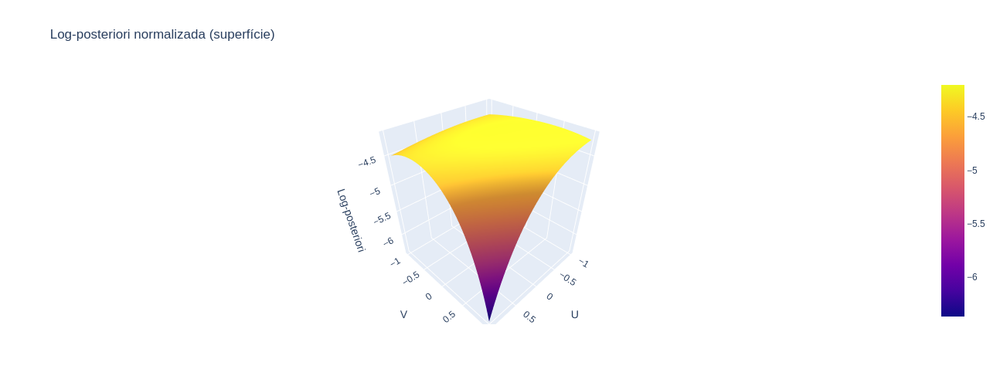

In [249]:
# Plot interativo
fig = go.Figure(
    go.Surface(
        x=u_vec,
        y=v_vec,
        z=z
    )
)

fig.update_layout(
    title='Log-posteriori normalizada (superfície)',
    autosize=False,
    width=500, height=500,
    scene=dict(
        xaxis_title='U',
        yaxis_title='V',
        zaxis_title='Log-posteriori',
    )
)
                 
fig.show()

In [250]:
def source_pdf(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf evaluated at x.
    """
    return np.exp(-x)/np.square(1+np.exp(-x))


def source_pdf_derivative(x):
    """
        This method takes SCALAR value x and return SCALAR source pdf derivative evaluated at x.
    """
    return (2*np.exp(-2*x)*(1+np.exp(-x)) - np.exp(-x)*np.square(1+np.exp(-x)))/np.power([1+np.exp(-x)],[4])

def prior_pdf(X):
    sig=0.1
    return np.exp(
        (-1/2/np.square(sig))*np.linalg.norm(X-np.eye(X.shape[0]))
    )

def prior_pdf_derivative(X):
    sig=0.1
    der_X=np.empty(X.shape)
    I=np.eye(X.shape[0])
    for i, j in np.ndindex(X.shape):
        der_X[i, j] = prior_pdf(X)*(-1/np.square(sig))*(X[i,j]-I[i,j])
    return der_X

## 3.1. Standard Gradient

In [251]:
# Initialize estimator
estimator = MAPGradientEstimator(
    learning_rate=learning_rate,
    thresh=thresh,
    max_it=max_it,
    source_pdf=source_pdf,
    source_pdf_derivative=source_pdf_derivative,
    prior_pdf=prior_pdf,
    prior_pdf_derivative=prior_pdf_derivative,
    is_natural_gradient=False
)

In [252]:
%%time

# Run optimization
estimator.fit(
    s=s,
    x=x,
    initial_condition=initial_B,
    n_initializations=1,
    n_jobs=os.cpu_count()-1
)

# Parse results
B=estimator.fit_results[0]['unmixing_matrix']
logs=estimator.fit_results[0]['logs']

print('-'*100)
print('Total iterations: {}'.format(logs.shape[0]))
print('Final log-posteriori: {}'.format(logs.iloc[-1]['log_posteriori']))
print('-'*100)

/home/leonardo/git/bayesian_bss/src/estimator.py:144: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



----------------------------------------------------------------------------------------------------
Total iterations: 25995
Final log-posteriori: -18662.43819753326
----------------------------------------------------------------------------------------------------
CPU times: user 2h 9min 12s, sys: 23min 18s, total: 2h 32min 31s
Wall time: 1h 47min


Text(0.5, 1.0, 'Evolução da prob. a posteriori ao longo das iterações')

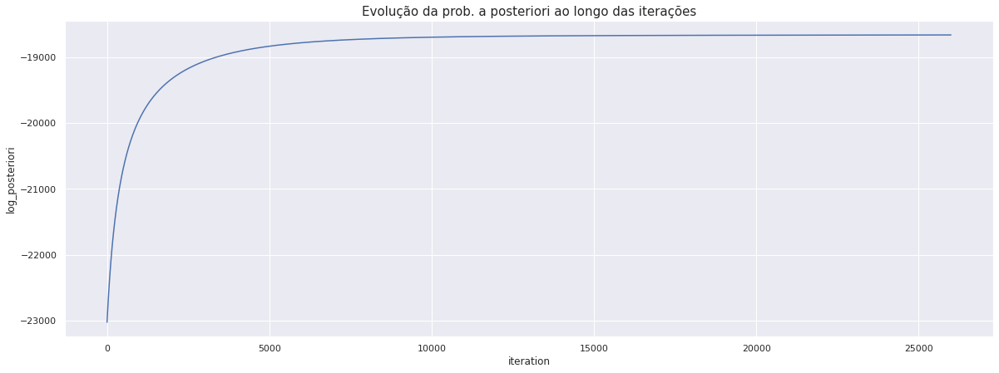

In [253]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='log_posteriori'
)
plt.title(
    'Evolução da prob. a posteriori ao longo das iterações',
    fontsize=15
)

Text(0.5, 1.0, 'Evolução do determinante de B ao longo das iterações')

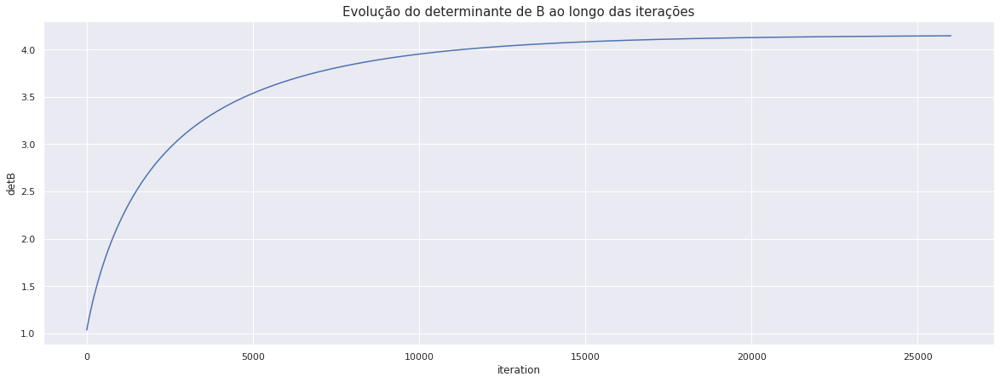

In [254]:
fig = plt.figure(figsize=(20,7))
sns.lineplot(
    data=logs,
    x='iteration',
    y='detB'
)
plt.title(
    'Evolução do determinante de B ao longo das iterações',
    fontsize=15
)

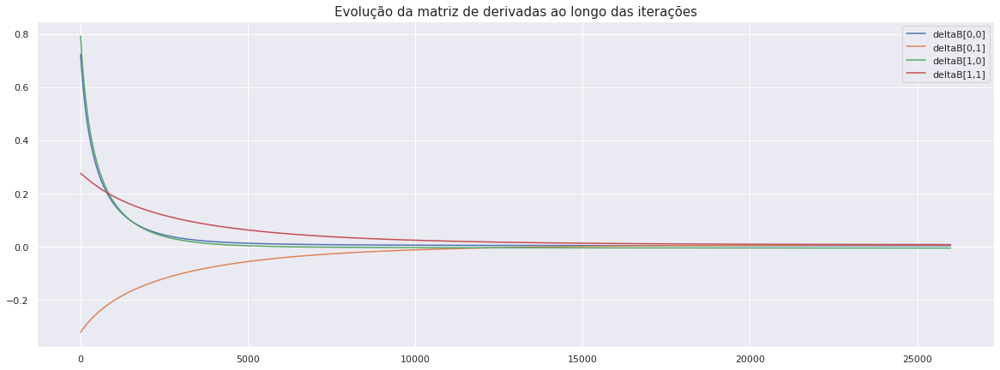

In [255]:
fig = plt.figure(figsize=(20,7))
for i, j in np.ndindex(B.shape):
    plt.plot(
        logs.iteration.values,
        [row['gradient'][i,j] for n, row in logs.iterrows()],
        label='deltaB[{},{}]'.format(i,j)
    )

plt.title(
    'Evolução da matriz de derivadas ao longo das iterações',
    fontsize=15
)
plt.legend()

In [256]:
B

array([[ 1.08159803, -1.93411187],
       [ 0.97957127,  2.0802218 ]])

In [257]:
np.linalg.inv(A)

array([[ 0.5, -1. ],
       [ 0.5,  1. ]])

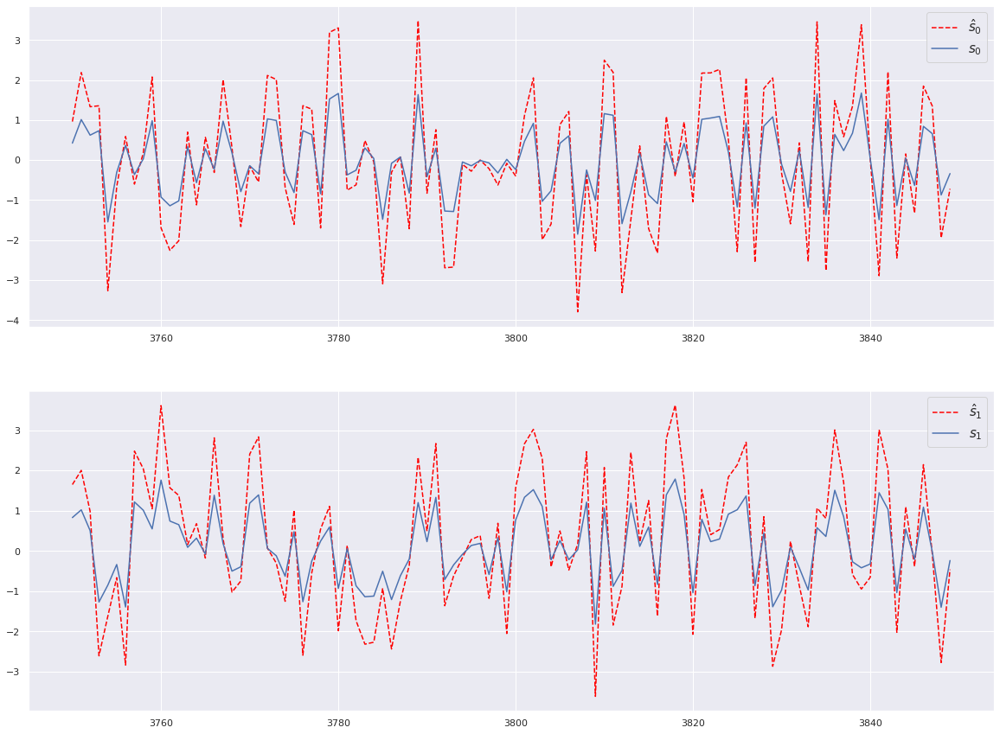

In [258]:
fig, (ax1, ax2) = plt.subplots(
    nrows=2, ncols=1,
    figsize=(20,15)
)
NPOINTS=100
PLOT_START=NOBS//2
PLOT_END=PLOT_START+NPOINTS

t=range(NOBS)
s_est = B@x

#Ax1
ax1.plot(
    t[PLOT_START:PLOT_END],
    s_est[0,PLOT_START:PLOT_END],
    label='$\hat{s}_{0}$',
    color='red',
    linestyle='--'
)
ax1.plot(
    t[PLOT_START:PLOT_END],
    s[0,PLOT_START:PLOT_END],
    label='$s_{0}$'
)
ax1.legend(fontsize=15)

#Ax2
ax2.plot(
    t[PLOT_START:PLOT_END],
    s_est[1,PLOT_START:PLOT_END],
    label='$\hat{s}_{1}$',
    color='red',
    linestyle='--'
)
ax2.plot(
    t[PLOT_START:PLOT_END],
    s[1,PLOT_START:PLOT_END],
    label='$s_{1}$'
)
ax2.legend(fontsize=15)



In [259]:
# Error norm
print('Norma do erro de estimação: {}'.format(
np.linalg.norm(
    np.subtract(s,s_est)
)/np.size(s)))

Norma do erro de estimação: 0.0068900262851350515
